https://docs.fast.ai/data.external.html

# Import

In [150]:
from pytorch_grad_cam import GradCAM, HiResCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, FullGrad, EigenGradCAM, LayerCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget

In [1]:
import torch 
from fastai.vision.all import *
from fastai.vision import *
import cv2

In [2]:
import numpy as np

In [3]:
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageFile
from PIL import Image
ImageFile.LOAD_TRUNCATED_IMAGES = True

In [5]:
from torchvision import *
import os

In [6]:
import rpy2
import rpy2.robjects as ro 
from rpy2.robjects.vectors import FloatVector 
from rpy2.robjects.packages import importr

# Data

In [862]:
path = untar_data(URLs.CALTECH_101);path

Path('/home/csy/.fastai/data/caltech_101')

In [863]:
path.ls()

(#102) [Path('/home/csy/.fastai/data/caltech_101/gerenuk'),Path('/home/csy/.fastai/data/caltech_101/ceiling_fan'),Path('/home/csy/.fastai/data/caltech_101/electric_guitar'),Path('/home/csy/.fastai/data/caltech_101/schooner'),Path('/home/csy/.fastai/data/caltech_101/sunflower'),Path('/home/csy/.fastai/data/caltech_101/brain'),Path('/home/csy/.fastai/data/caltech_101/dolphin'),Path('/home/csy/.fastai/data/caltech_101/nautilus'),Path('/home/csy/.fastai/data/caltech_101/panda'),Path('/home/csy/.fastai/data/caltech_101/chair')...]

In [864]:
dls = ImageDataLoaders.from_folder(path, valid_pct=0.2, seed=42, item_tfms=Resize(512), 
                                   batch_tfms=[*aug_transforms(), Normalize.from_stats(*imagenet_stats)])

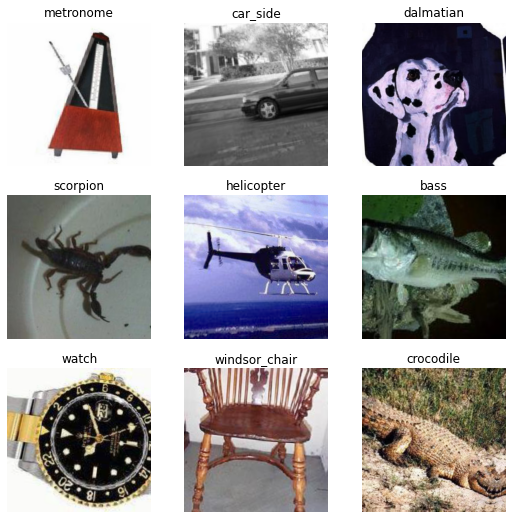

In [865]:
dls.show_batch()

In [11]:
lrnr=cnn_learner(dls,resnet34,metrics=error_rate)
lrnr.fine_tune(1)

/home/csy/anaconda3/envs/temp_csy/lib/python3.8/site-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/home/csy/anaconda3/envs/temp_csy/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/csy/anaconda3/envs/temp_csy/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,error_rate,time
0,2.786667,1.086679,0.280635,00:46


epoch,train_loss,valid_loss,error_rate,time
0,0.953599,0.546696,0.141685,00:59


In [12]:
net1=lrnr.model[0]
net2=lrnr.model[1] 

In [13]:
net2

Sequential(
  (0): AdaptiveConcatPool2d(
    (ap): AdaptiveAvgPool2d(output_size=1)
    (mp): AdaptiveMaxPool2d(output_size=1)
  )
  (1): fastai.layers.Flatten(full=False)
  (2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): Dropout(p=0.25, inplace=False)
  (4): Linear(in_features=1024, out_features=512, bias=False)
  (5): ReLU(inplace=True)
  (6): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): Dropout(p=0.5, inplace=False)
  (8): Linear(in_features=512, out_features=102, bias=False)
)

In [14]:
net2 = torch.nn.Sequential(
    torch.nn.AdaptiveAvgPool2d(output_size=1), 
    torch.nn.Flatten(),
    torch.nn.Linear(512,out_features=102,bias=False))

In [15]:
net=torch.nn.Sequential(net1,net2)

In [16]:
lrnr2=Learner(dls,net,metrics=accuracy) 

In [17]:
lrnr2.fine_tune(5) 

epoch,train_loss,valid_loss,accuracy,time
0,2.200760,3.150540,0.371444,00:59


epoch,train_loss,valid_loss,accuracy,time
0,1.145681,1.464551,0.653173,00:59
1,1.119536,1.774413,0.589716,00:58
2,0.751984,0.828347,0.771335,00:59
3,0.415494,0.496882,0.862144,00:59
4,0.232705,0.418902,0.882385,00:59


# Step

<Axes: >

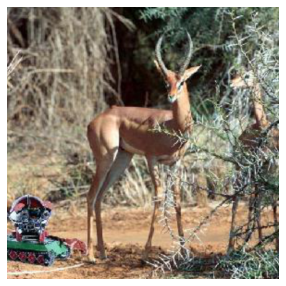

In [866]:
x, = first(dls.test_dl([PILImage.create(get_image_files(path)[20])]))
dls.train.decode((x,))[0].squeeze().show()

In [868]:
x = x.to('cpu')

In [869]:
camimg = torch.einsum('ij,jkl -> ikl', net2[2].weight, net1(x).squeeze())

In [870]:
ebayesthresh = importr('EbayesThresh').ebayesthresh

power_threshed=np.array(ebayesthresh(FloatVector(torch.tensor(camimg[0].detach().reshape(-1))**2)))
ybar_threshed = np.where(power_threshed>80,torch.tensor(camimg[0].detach().reshape(-1)).cpu(),0)
ybar_threshed = torch.tensor(ybar_threshed.reshape(16,16))

power_threshed2=np.array(ebayesthresh(FloatVector(torch.tensor(camimg[1].detach().reshape(-1))**2)))
ybar_threshed2 = np.where(power_threshed2>80,torch.tensor(camimg[1].detach().reshape(-1)).cpu(),0)
ybar_threshed2 = torch.tensor(ybar_threshed2.reshape(16,16))

<ipython-input-870-11d406c6ed63>:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  power_threshed=np.array(ebayesthresh(FloatVector(torch.tensor(camimg[0].detach().reshape(-1))**2)))
<ipython-input-870-11d406c6ed63>:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  ybar_threshed = np.where(power_threshed>80,torch.tensor(camimg[0].detach().reshape(-1)).cpu(),0)
<ipython-input-870-11d406c6ed63>:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  power_threshed2=np.array(ebayesthresh(FloatVector(torch.tensor(camimg[1].detach().reshape(-1))**2)))


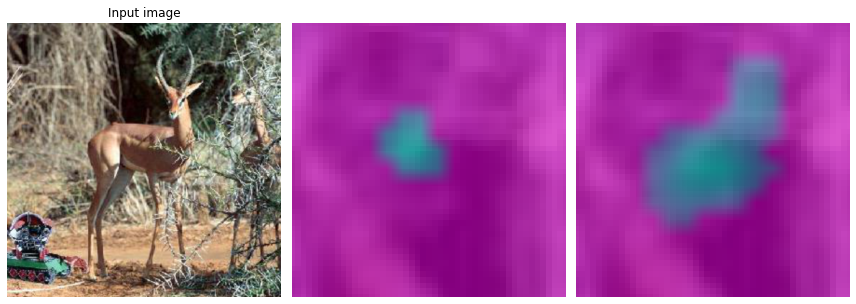

In [871]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3) 
# 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.set_title("Input image")
# 
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow((ybar_threshed).to("cpu").detach(),alpha=0.5,extent=(0,48,48,0),interpolation='bilinear',cmap='cool')
# ax2.set_title("CAT PART")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax3)
ax3.imshow((ybar_threshed2).to("cpu").detach(),alpha=0.5,extent=(0,48,48,0),interpolation='bilinear',cmap='cool')
# ax3.set_title("DOG PART")
#
fig.set_figwidth(12)            
fig.set_figheight(12)
fig.tight_layout()

- 판단 근거가 강할 수록 파란색 -> 보라색

## mode 1

In [872]:
# test=camimg_o[0]-torch.min(camimg_o[0])
A1=torch.exp(-0.05*(ybar_threshed))
A2 = 1 - A1

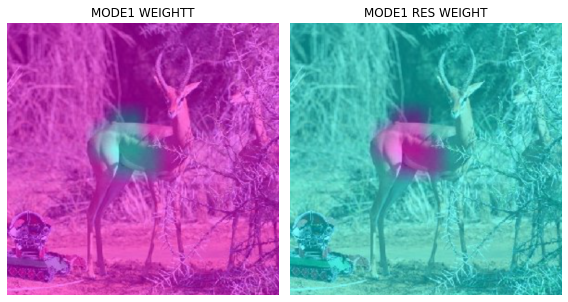

In [873]:
fig, (ax1,ax2) = plt.subplots(1,2) 
# 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.imshow(A2.data.to("cpu").detach(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("MODE1 WEIGHTT")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow(A1.data.to("cpu").detach(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("MODE1 RES WEIGHT")
#
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

In [874]:
# mode 1 res
X1=np.array(A1.to("cpu").detach(),dtype=np.float32)
Y1=torch.Tensor(cv2.resize(X1,(512,512),interpolation=cv2.INTER_LINEAR))
x1=x.squeeze().to('cpu')*Y1-torch.min(x.squeeze().to('cpu'))*Y1

# mode 1
X12=np.array(A2.to("cpu").detach(),dtype=np.float32)
Y12=torch.Tensor(cv2.resize(X12,(512,512),interpolation=cv2.INTER_LINEAR))
x12=x.squeeze().to('cpu')*Y12-torch.min(x.squeeze().to('cpu'))*Y12

`-` 1st CAM 분리

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


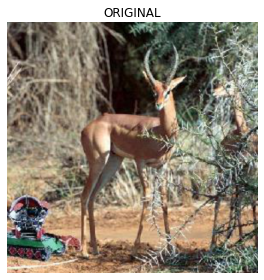

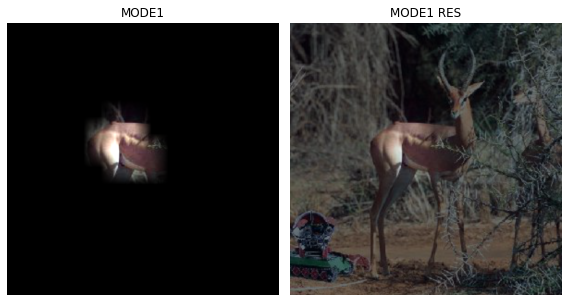

In [896]:
fig, (ax1) = plt.subplots(1,1) 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.set_title("ORIGINAL")
fig.set_figwidth(4)            
fig.set_figheight(4)
fig.tight_layout()
#
fig, (ax1, ax2) = plt.subplots(1,2) 
(-x12*0.3).squeeze().show(ax=ax1)  #MODE1
(x1*0.1).squeeze().show(ax=ax2)  #MODE1_res
ax1.set_title("MODE1")
ax2.set_title("MODE1 RES")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

In [897]:
x1 = x1.reshape(1,3,512,512)

In [898]:
net1.to('cpu')
net2.to('cpu')

Sequential(
  (0): AdaptiveAvgPool2d(output_size=1)
  (1): Flatten(start_dim=1, end_dim=-1)
  (2): Linear(in_features=512, out_features=102, bias=False)
)

In [899]:
camimg1 = torch.einsum('ij,jkl -> ikl', net2[2].weight, net1(x1).squeeze())

In [900]:
power_threshed3=np.array(ebayesthresh(FloatVector(torch.tensor(camimg1[0].detach().reshape(-1))**2)))
ybar_threshed3 = np.where(power_threshed3>10,torch.tensor(camimg1[0].detach().reshape(-1)),0)
ybar_threshed3 = torch.tensor(ybar_threshed3.reshape(16,16))

power_threshed4=np.array(ebayesthresh(FloatVector(torch.tensor(camimg1[1].detach().reshape(-1))**2)))
ybar_threshed4 = np.where(power_threshed4>10,torch.tensor(camimg1[1].detach().reshape(-1)),0)
ybar_threshed4 = torch.tensor(ybar_threshed4.reshape(16,16))

<ipython-input-900-292f842a7fbc>:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  power_threshed3=np.array(ebayesthresh(FloatVector(torch.tensor(camimg1[0].detach().reshape(-1))**2)))
<ipython-input-900-292f842a7fbc>:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  ybar_threshed3 = np.where(power_threshed3>10,torch.tensor(camimg1[0].detach().reshape(-1)),0)
<ipython-input-900-292f842a7fbc>:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  power_threshed4=np.array(ebayesthresh(FloatVector(torch.tensor(camimg1[1].detach().reshape(-1))**2)))


`-` mode1 res 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


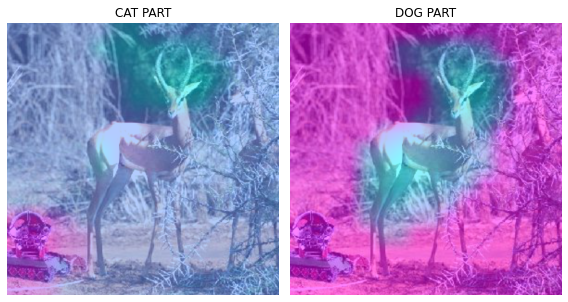

In [901]:
fig, (ax1,ax2) = plt.subplots(1,2) 
# 
(x1*0.25).squeeze().show(ax=ax1)
ax1.imshow(ybar_threshed3,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("CAT PART")
#
(x1*0.25).squeeze().show(ax=ax2)
ax2.imshow(ybar_threshed4,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DOG PART")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

`-` 첫번째 CAM 결과와 비교

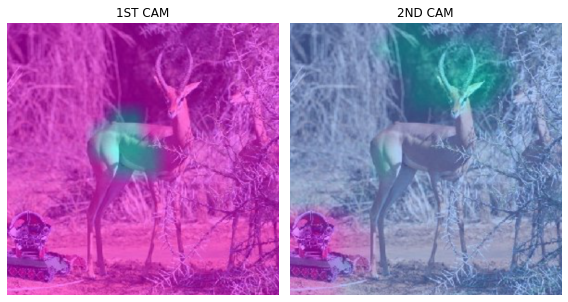

In [902]:
fig, (ax1,ax2) = plt.subplots(1,2) 
# 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.imshow(ybar_threshed,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("1ST CAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow(ybar_threshed3,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("2ND CAM")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

`-` 2nd CAM 분리

In [903]:
# test1=camimg1[0]-torch.min(camimg1[0])
A3 = torch.exp(-0.05*(ybar_threshed3))
A4 = 1 - A3

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


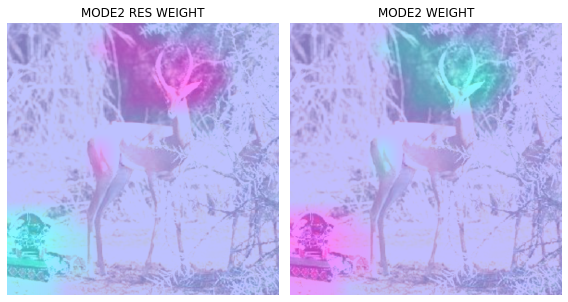

In [904]:
fig, (ax1,ax2) = plt.subplots(1,2) 
# 
x1.squeeze().show(ax=ax2)
dls.train.decode((x1,))[0].squeeze().show(ax=ax1)
ax1.imshow(A3.data.to("cpu").detach(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("MODE2 RES WEIGHT")
#
x1.squeeze().show(ax=ax2)
dls.train.decode((x1,))[0].squeeze().show(ax=ax2)
ax2.imshow(A4.data.to("cpu").detach(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("MODE2 WEIGHT")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

In [905]:
X2=np.array(A3.to("cpu").detach(),dtype=np.float32)
Y2=torch.Tensor(cv2.resize(X2,(512,512),interpolation=cv2.INTER_LINEAR))
x2=(x1)*Y2-torch.min((x1)*Y2)

X22=np.array(A4.to("cpu").detach(),dtype=np.float32)
Y22=torch.Tensor(cv2.resize(X22,(512,512),interpolation=cv2.INTER_LINEAR))
x22=(x1)*Y22-torch.min((x1)*Y22)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


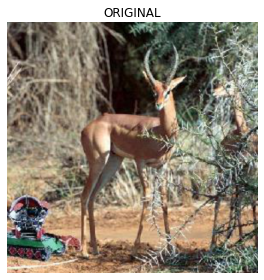

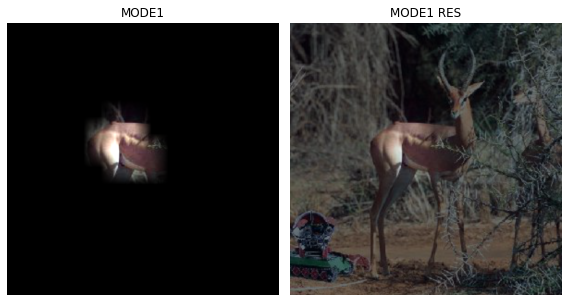

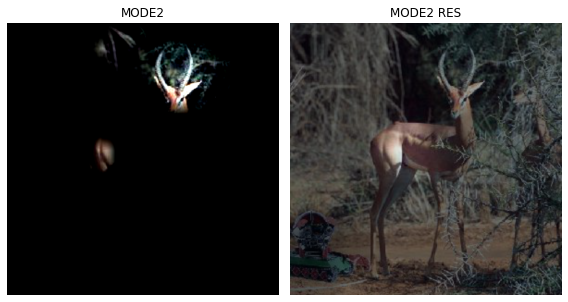

In [915]:
fig, (ax1) = plt.subplots(1,1) 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.set_title("ORIGINAL")
fig.set_figwidth(4)            
fig.set_figheight(4)
fig.tight_layout()
#
fig, (ax1, ax2) = plt.subplots(1,2) 
(-x12*0.3).squeeze().show(ax=ax1)  #MODE1
(x1*0.1).squeeze().show(ax=ax2)  #MODE1_res
ax1.set_title("MODE1")
ax2.set_title("MODE1 RES")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()
#
fig, (ax1, ax2) = plt.subplots(1,2) 
(-x22+1.7).squeeze().show(ax=ax1)  #MODE2
(x2*0.1).squeeze().show(ax=ax2)  #MODE2_res
ax1.set_title("MODE2")
ax2.set_title("MODE2 RES")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

In [916]:
x2 = x2.reshape(1,3,512,512)

In [917]:
net1.to('cpu')
net2.to('cpu')

Sequential(
  (0): AdaptiveAvgPool2d(output_size=1)
  (1): Flatten(start_dim=1, end_dim=-1)
  (2): Linear(in_features=512, out_features=102, bias=False)
)

In [918]:
camimg2 = torch.einsum('ij,jkl -> ikl', net2[2].weight, net1(x2).squeeze())

In [919]:
power_threshed5=np.array(ebayesthresh(FloatVector(torch.tensor(camimg2[0].detach().reshape(-1))**2)))
ybar_threshed5 = np.where(power_threshed5>40,torch.tensor(camimg2[0].detach().reshape(-1)),0)
ybar_threshed5 = torch.tensor(ybar_threshed5.reshape(16,16))

power_threshed6=np.array(ebayesthresh(FloatVector(torch.tensor(camimg2[1].detach().reshape(-1))**2)))
ybar_threshed6 = np.where(power_threshed6>40,torch.tensor(camimg2[1].detach().reshape(-1)),0)
ybar_threshed6 = torch.tensor(ybar_threshed6.reshape(16,16))

<ipython-input-919-ba6e482cf5c4>:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  power_threshed5=np.array(ebayesthresh(FloatVector(torch.tensor(camimg2[0].detach().reshape(-1))**2)))
<ipython-input-919-ba6e482cf5c4>:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  ybar_threshed5 = np.where(power_threshed5>40,torch.tensor(camimg2[0].detach().reshape(-1)),0)
<ipython-input-919-ba6e482cf5c4>:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  power_threshed6=np.array(ebayesthresh(FloatVector(torch.tensor(camimg2[1].detach().reshape(-1))**2)))


`-` mode2 res 에 CAM 결과 올리기

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


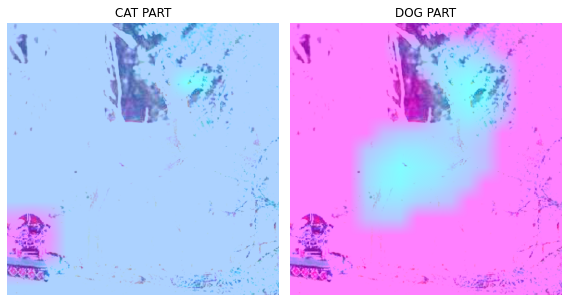

In [920]:
fig, (ax1, ax2) = plt.subplots(1,2) 
#
x2.squeeze().show(ax=ax1)
ax1.imshow(ybar_threshed5,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("CAT PART")
#
x2.squeeze().show(ax=ax2)
ax2.imshow(ybar_threshed6,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DOG PART")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

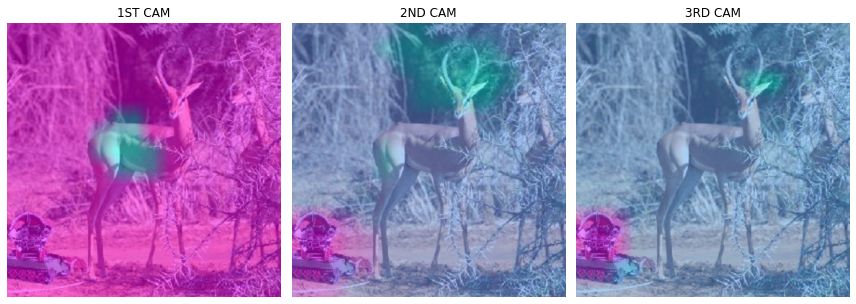

In [921]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3) 
# 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.imshow(ybar_threshed,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("1ST CAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow(ybar_threshed3,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("2ND CAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax3)
ax3.imshow(ybar_threshed5,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax3.set_title("3RD CAM")
fig.set_figwidth(12)            
fig.set_figheight(12)
fig.tight_layout()

## mode 3 만들기

In [922]:
# test2=camimg2[0]-torch.min(camimg2[0])

In [923]:
A5 = torch.exp(-0.05*(ybar_threshed5))

In [924]:
A6 = 1 - A5

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


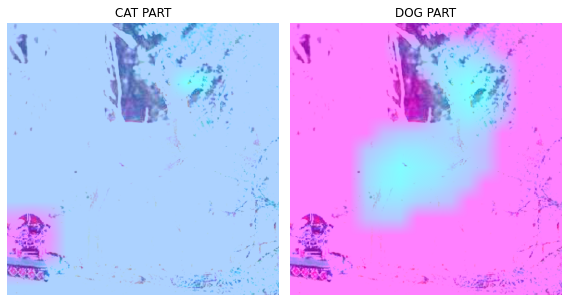

In [925]:
fig, (ax1, ax2) = plt.subplots(1,2) 
#
x2.squeeze().show(ax=ax1)
ax1.imshow(ybar_threshed5,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("CAT PART")
#
x2.squeeze().show(ax=ax2)
ax2.imshow(ybar_threshed6,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DOG PART")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

In [926]:
#mode 3 res
X3=np.array(A5.to("cpu").detach(),dtype=np.float32)
Y3=torch.Tensor(cv2.resize(X3,(512,512),interpolation=cv2.INTER_LINEAR))
x3=x2*Y3-torch.min(x2*Y3)
# mode 3
X32=np.array(A6.to("cpu").detach(),dtype=np.float32)
Y32=torch.Tensor(cv2.resize(X32,(512,512),interpolation=cv2.INTER_LINEAR))
x32=x2*Y32-torch.min(x2*Y32)

In [927]:
import pickle

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


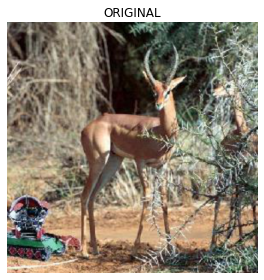

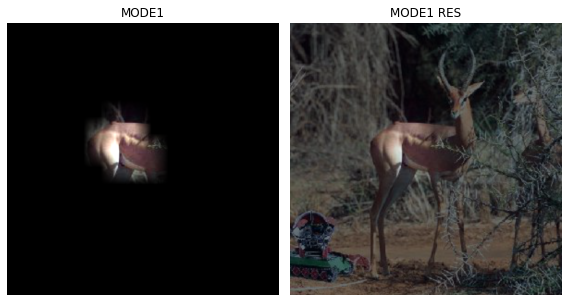

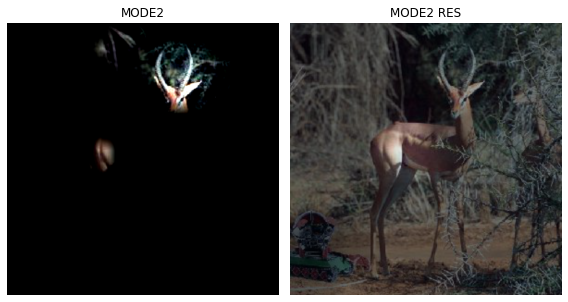

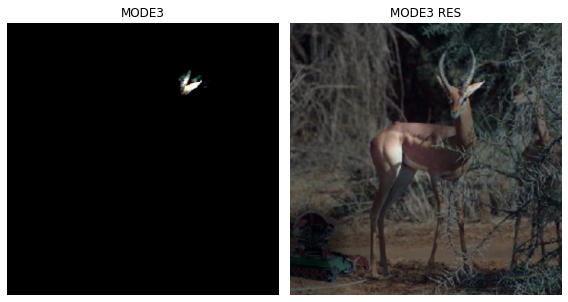

In [932]:
fig, (ax1) = plt.subplots(1,1) 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.set_title("ORIGINAL")
fig.set_figwidth(4)            
fig.set_figheight(4)
fig.tight_layout()

with open('CALTECH_101_hcam_cat_plt1.pkl', 'wb') as file:
    pickle.dump(fig, file)
#
fig, (ax1, ax2) = plt.subplots(1,2) 
(-x12*0.3).squeeze().show(ax=ax1)  #MODE1
(x1*0.1).squeeze().show(ax=ax2)  #MODE1_res
ax1.set_title("MODE1")
ax2.set_title("MODE1 RES")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()
with open('CALTECH_101_hcam_cat_plt2.pkl', 'wb') as file:
    pickle.dump(fig, file)
    
#
fig, (ax1, ax2) = plt.subplots(1,2) 
(-x22+1.7).squeeze().show(ax=ax1)  #MODE2
(x2*0.1).squeeze().show(ax=ax2)  #MODE2_res
ax1.set_title("MODE2")
ax2.set_title("MODE2 RES")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()
with open('CALTECH_101_hcam_cat_plt3.pkl', 'wb') as file:
    pickle.dump(fig, file)
    
#
fig, (ax1, ax2) = plt.subplots(1,2) 
(-x32+2).squeeze().show(ax=ax1)  #MODE3
(x3*0.1).squeeze().show(ax=ax2)  #MODE3_res
ax1.set_title("MODE3")
ax2.set_title("MODE3 RES")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

with open('CALTECH_101_hcam_cat_plt4.pkl', 'wb') as file:
    pickle.dump(fig, file)

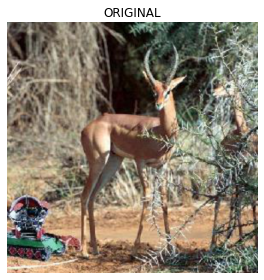

In [933]:
with open('CALTECH_101_hcam_cat_plt1.pkl', 'rb') as file:
    hcam_cat_plt = pickle.load(file)
plt.show(hcam_cat_plt)

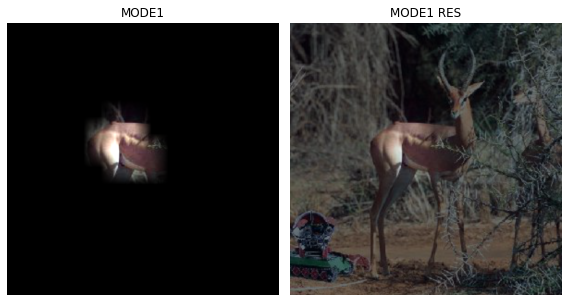

In [934]:
with open('CALTECH_101_hcam_cat_plt2.pkl', 'rb') as file:
    hcam_cat_plt = pickle.load(file)
plt.show(hcam_cat_plt)

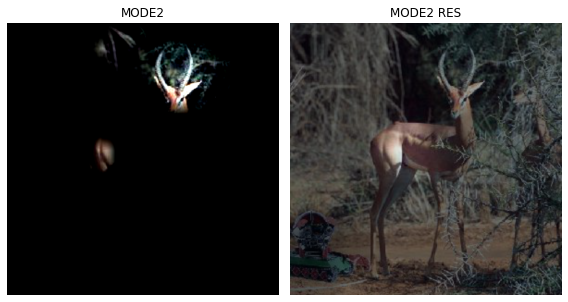

In [935]:
with open('CALTECH_101_hcam_cat_plt3.pkl', 'rb') as file:
    hcam_cat_plt = pickle.load(file)
plt.show(hcam_cat_plt)

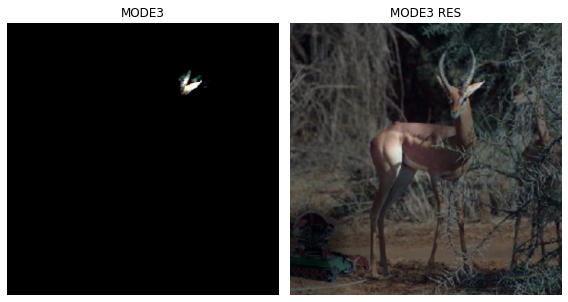

In [936]:
with open('CALTECH_101_hcam_cat_plt4.pkl', 'rb') as file:
    hcam_cat_plt = pickle.load(file)
plt.show(hcam_cat_plt)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


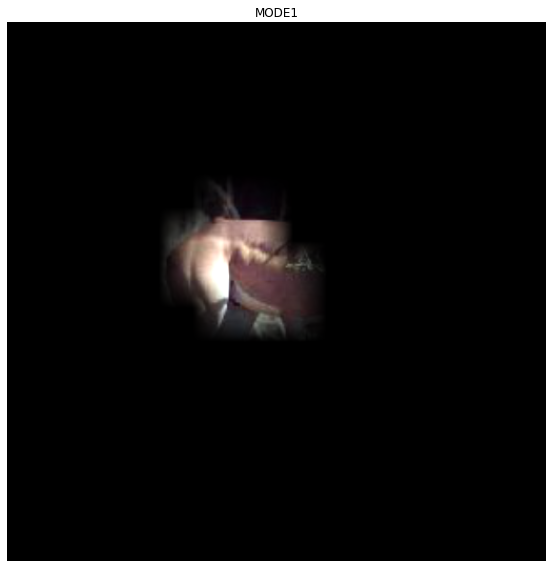

In [937]:
fig, (ax1) = plt.subplots(1,1) 
(x12*-0.3).squeeze().show(ax=ax1)  #MODE1
ax1.set_title("MODE1")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

with open('CALTECH_101_hcam_cat_plt_mode1.pkl', 'wb') as file:
    pickle.dump(fig, file)

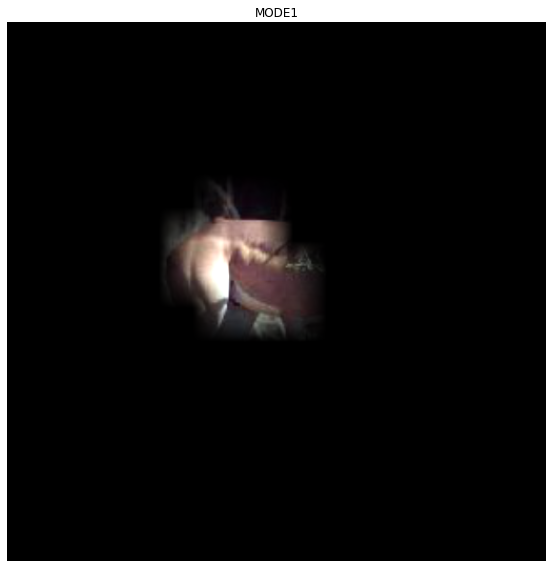

In [938]:
with open('CALTECH_101_hcam_cat_plt_mode1.pkl', 'rb') as file:
    hcam_cat_plt_mode1 = pickle.load(file)
plt.show(hcam_cat_plt_mode1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


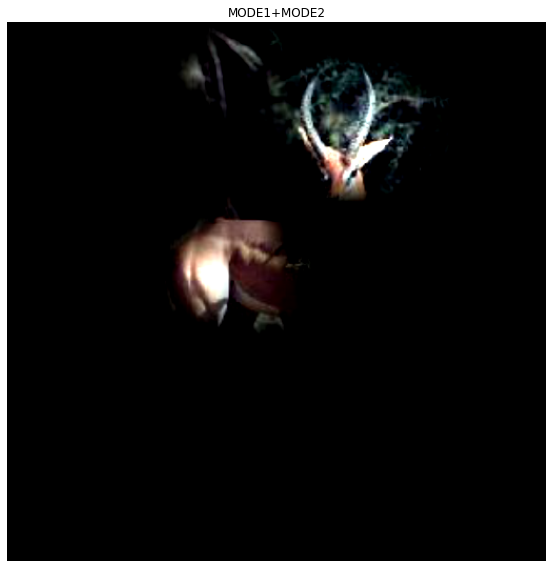

In [939]:
fig, (ax1) = plt.subplots(1,1) 
(-x12*0.3 + -x22+1.7).squeeze().show(ax=ax1)  #MODE1+MODE2
ax1.set_title("MODE1+MODE2")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

with open('CALTECH_101_hcam_cat_plt_mode2.pkl', 'wb') as file:
    pickle.dump(fig, file)

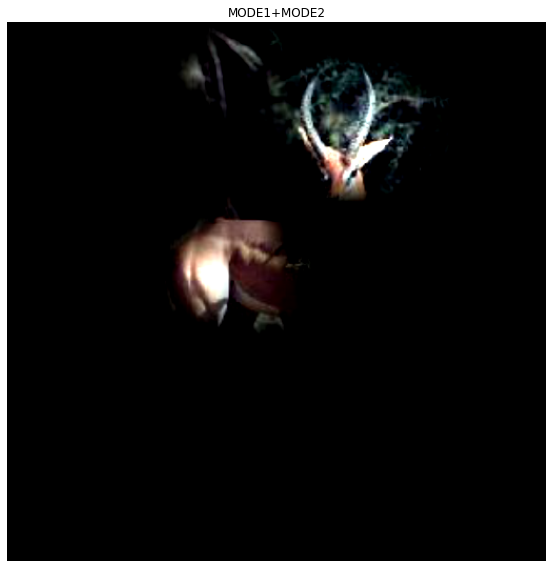

In [940]:
with open('CALTECH_101_hcam_cat_plt_mode2.pkl', 'rb') as file:
    hcam_cat_plt_mode2 = pickle.load(file)
plt.show(hcam_cat_plt_mode2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


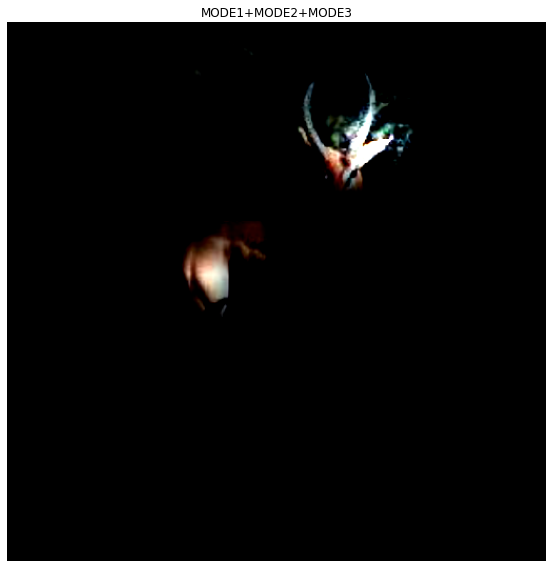

In [942]:
fig, (ax1) = plt.subplots(1,1) 
(x12*-0.3 + -x22+1.7 + -x32+2).squeeze().show(ax=ax1)  #MODE1+MODE2+MODE3
ax1.set_title("MODE1+MODE2+MODE3")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

with open('CALTECH_101_hcam_cat_plt_mode3.pkl', 'wb') as file:
    pickle.dump(fig, file)

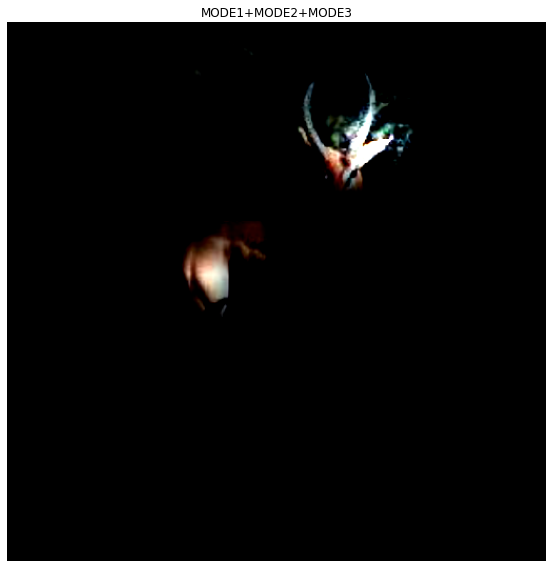

In [943]:
with open('CALTECH_101_hcam_cat_plt_mode3.pkl', 'rb') as file:
    hcam_cat_plt_mode3 = pickle.load(file)
plt.show(hcam_cat_plt_mode3)

# Other Methods

In [151]:
model = resnet34(pretrained=True)

target_layer = [model.layer4[-1]]
gradcam = GradCAM(model=model, target_layers=target_layer)

/home/csy/anaconda3/envs/temp_csy/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/csy/anaconda3/envs/temp_csy/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [152]:
model = resnet34(pretrained=True)

target_layer = [model.layer4[-1]]
hirescam = HiResCAM(model=model, target_layers=target_layer)

In [153]:
model = resnet34(pretrained=True)

target_layer = [model.layer4[-1]]
scorecam = ScoreCAM(model=model, target_layers=target_layer)

In [154]:
model = resnet34(pretrained=True)

target_layer = [model.layer4[-1]]
gradcamplusplus = GradCAMPlusPlus(model=model, target_layers=target_layer)

In [155]:
model = resnet34(pretrained=True)

target_layer = [model.layer4[-1]]
ablationcam = AblationCAM(model=model, target_layers=target_layer)

In [156]:
model = resnet34(pretrained=True)

target_layer = [model.layer4[-1]]
xgradcam = XGradCAM(model=model, target_layers=target_layer)

In [157]:
model = resnet34(pretrained=True)

target_layer = [model.layer4[-1]]
eigencam = EigenCAM(model=model, target_layers=target_layer)

In [158]:
model = resnet34(pretrained=True)

target_layer = [model.layer4[-1]]
fullgrad = FullGrad(model=model, target_layers=target_layer)

In [159]:
model = resnet34(pretrained=True)

target_layer = [model.layer4[-1]]
eigengradcam = EigenGradCAM(model=model, target_layers=target_layer)

In [160]:
model = resnet34(pretrained=True)

target_layer = [model.layer4[-1]]
layercam = LayerCAM(model=model, target_layers=target_layer)

## 시도

<Axes: >

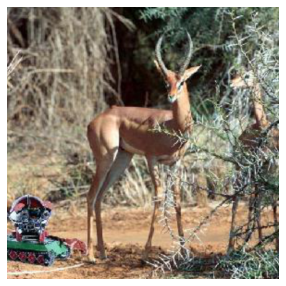

In [186]:
x, = first(dls.test_dl([PILImage.create(get_image_files(path)[20])]))
x = x.to('cpu')
dls.train.decode((x,))[0].squeeze().show()

In [187]:
cam_gradcam = gradcam(input_tensor=x,targets=None)

In [188]:
cam_hirescam = hirescam(input_tensor=x,targets=None)

In [189]:
cam_scorecam = scorecam(input_tensor=x,targets=None)

100%|██████████| 32/32 [00:23<00:00,  1.38it/s]


In [190]:
cam_gradcamplusplus = gradcamplusplus(input_tensor=x,targets=None)

In [191]:
cam_ablationcam = ablationcam(input_tensor=x,targets=None)

100%|██████████| 16/16 [00:26<00:00,  1.63s/it]


In [192]:
cam_xgradcam = xgradcam(input_tensor=x,targets=None)

In [193]:
cam_eigencam = eigencam(input_tensor=x,targets=None)

In [194]:
cam_fullgrad = fullgrad(input_tensor=x,targets=None)

In [195]:
cam_eigengradcam = eigengradcam(input_tensor=x,targets=None)

In [196]:
cam_layercam = layercam(input_tensor=x,targets=None)

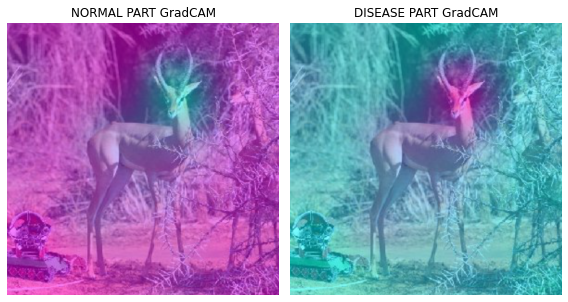

In [206]:
fig, (ax1,ax2) = plt.subplots(1,2) 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.imshow(-cam_gradcam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("NORMAL PART GradCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow(cam_gradcam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DISEASE PART GradCAM")
#
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

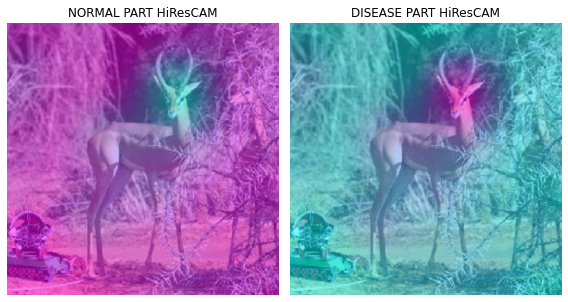

In [207]:
fig, (ax1,ax2) = plt.subplots(1,2) 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.imshow(-cam_hirescam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("NORMAL PART HiResCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow(cam_hirescam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DISEASE PART HiResCAM")
#
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

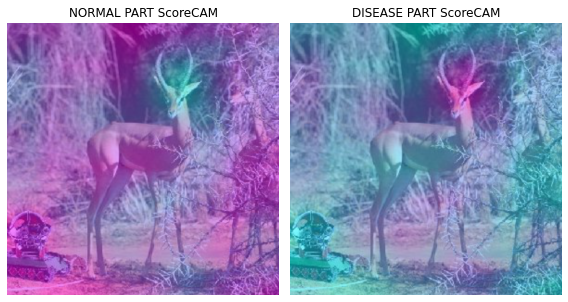

In [208]:
fig, (ax1,ax2) = plt.subplots(1,2) 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.imshow(-cam_scorecam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("NORMAL PART ScoreCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow(cam_scorecam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DISEASE PART ScoreCAM")
#
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

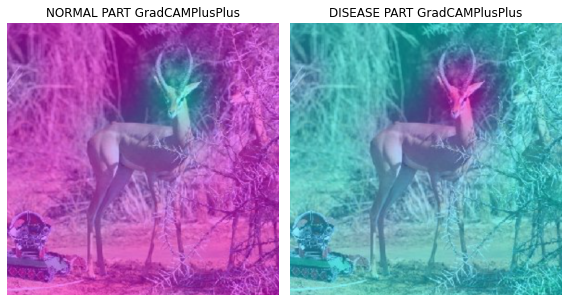

In [209]:
fig, (ax1,ax2) = plt.subplots(1,2) 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.imshow(-cam_gradcamplusplus.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("NORMAL PART GradCAMPlusPlus")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow(cam_gradcamplusplus.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DISEASE PART GradCAMPlusPlus")
#
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

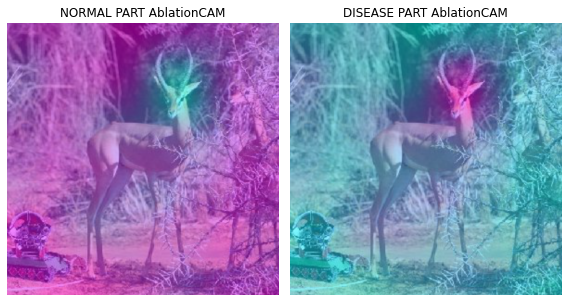

In [210]:
fig, (ax1,ax2) = plt.subplots(1,2) 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.imshow(-cam_ablationcam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("NORMAL PART AblationCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow(cam_ablationcam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DISEASE PART AblationCAM")
#
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

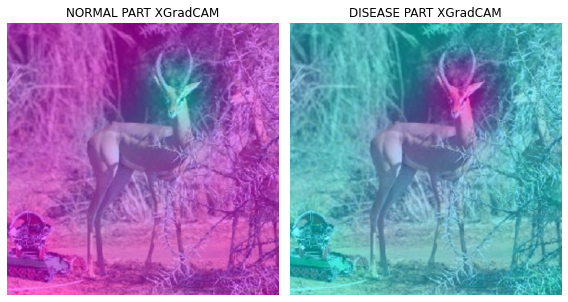

In [211]:
fig, (ax1,ax2) = plt.subplots(1,2) 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.imshow(-cam_xgradcam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("NORMAL PART XGradCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow(cam_xgradcam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DISEASE PART XGradCAM")
#
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

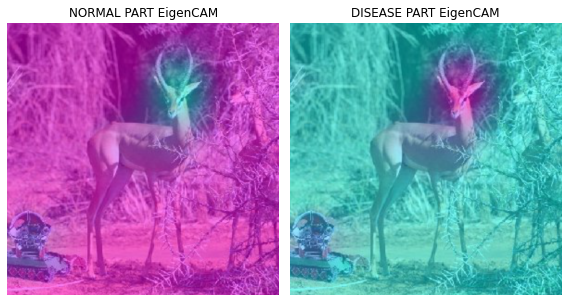

In [212]:
fig, (ax1,ax2) = plt.subplots(1,2) 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.imshow(-cam_eigencam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("NORMAL PART EigenCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow(cam_eigencam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DISEASE PART EigenCAM")
#
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

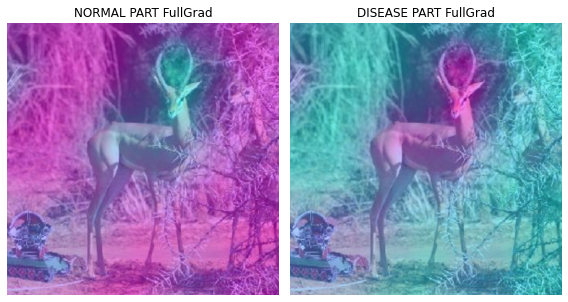

In [213]:
fig, (ax1,ax2) = plt.subplots(1,2) 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.imshow(-cam_fullgrad.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("NORMAL PART FullGrad")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow(cam_fullgrad.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DISEASE PART FullGrad")
#
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

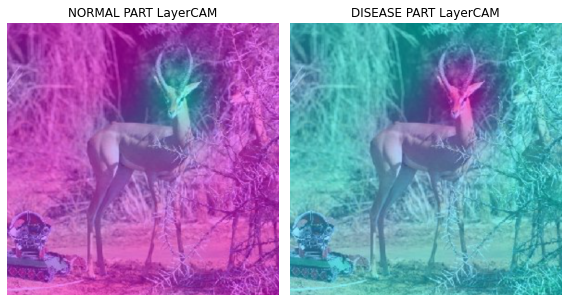

In [217]:
fig, (ax1,ax2) = plt.subplots(1,2) 
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.imshow(-cam_layercam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("NORMAL PART LayerCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow(cam_layercam.squeeze(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DISEASE PART LayerCAM")
#
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

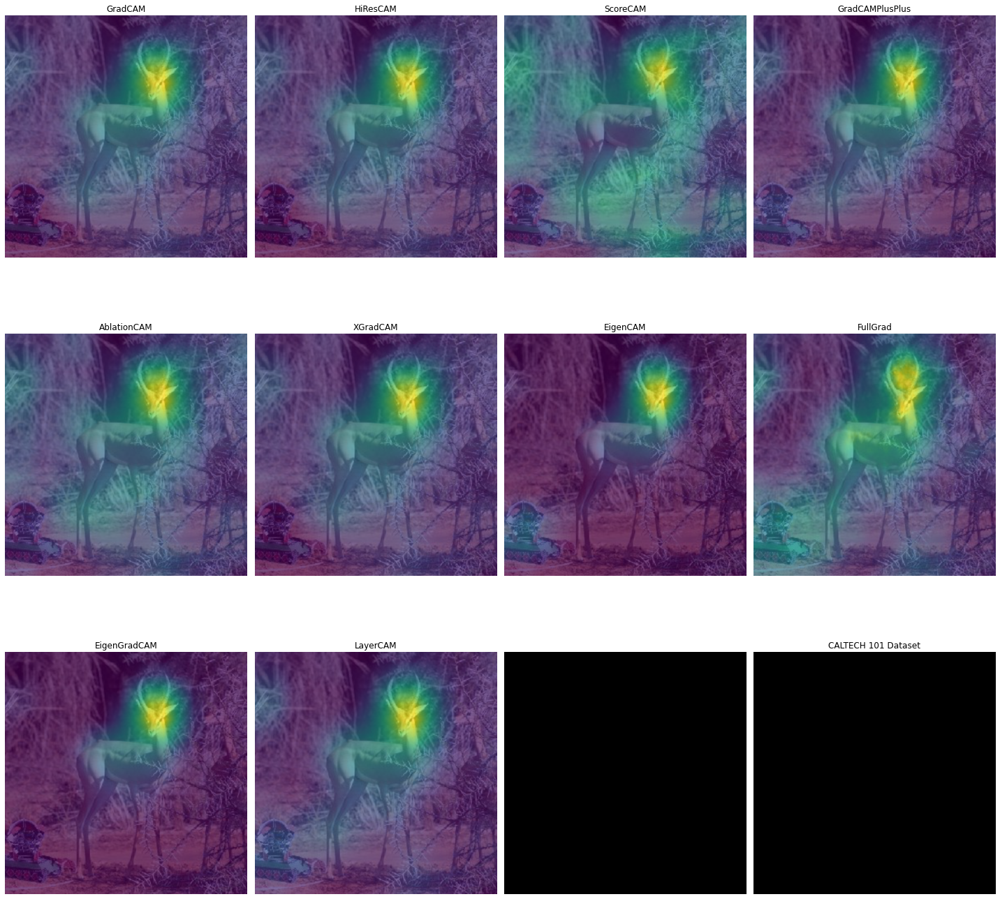

In [231]:
fig, ((ax1,ax2,ax3,ax4),
      (ax5,ax6,ax7,ax8),
      (ax9,ax10,ax11,ax12)) = plt.subplots(3,4) 
plt.title('CALTECH 101 Dataset')
#
dls.train.decode((x,))[0].squeeze().show(ax=ax1)
ax1.imshow(cam_gradcam.squeeze(), alpha=0.7)
ax1.set_title("GradCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax2)
ax2.imshow(cam_hirescam.squeeze(), alpha=0.7)
ax2.set_title("HiResCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax3)
ax3.imshow(cam_scorecam.squeeze(), alpha=0.7)
ax3.set_title("ScoreCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax4)
ax4.imshow(cam_gradcamplusplus.squeeze(), alpha=0.7)
ax4.set_title("GradCAMPlusPlus")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax5)
ax5.imshow(cam_ablationcam.squeeze(), alpha=0.7)
ax5.set_title("AblationCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax6)
ax6.imshow(cam_xgradcam.squeeze(), alpha=0.7)
ax6.set_title("XGradCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax7)
ax7.imshow(cam_eigencam.squeeze(), alpha=0.7)
ax7.set_title("EigenCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax8)
ax8.imshow(cam_fullgrad.squeeze(), alpha=0.7)
ax8.set_title("FullGrad")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax9)
ax9.imshow(cam_eigengradcam.squeeze(), alpha=0.7)
ax9.set_title("EigenGradCAM")
#
dls.train.decode((x,))[0].squeeze().show(ax=ax10)
ax10.imshow(cam_layercam.squeeze(), alpha=0.7)
ax10.set_title("LayerCAM")

(dls.train.decode((x,))[0].squeeze()*0).show(ax=ax11)
(dls.train.decode((x,))[0].squeeze()*0).show(ax=ax12)
#
fig.set_figwidth(20)            
fig.set_figheight(20)
fig.tight_layout()

with open('CALTECH_101_fig_randombox_plt.pkl', 'wb') as file:
    pickle.dump(fig, file)

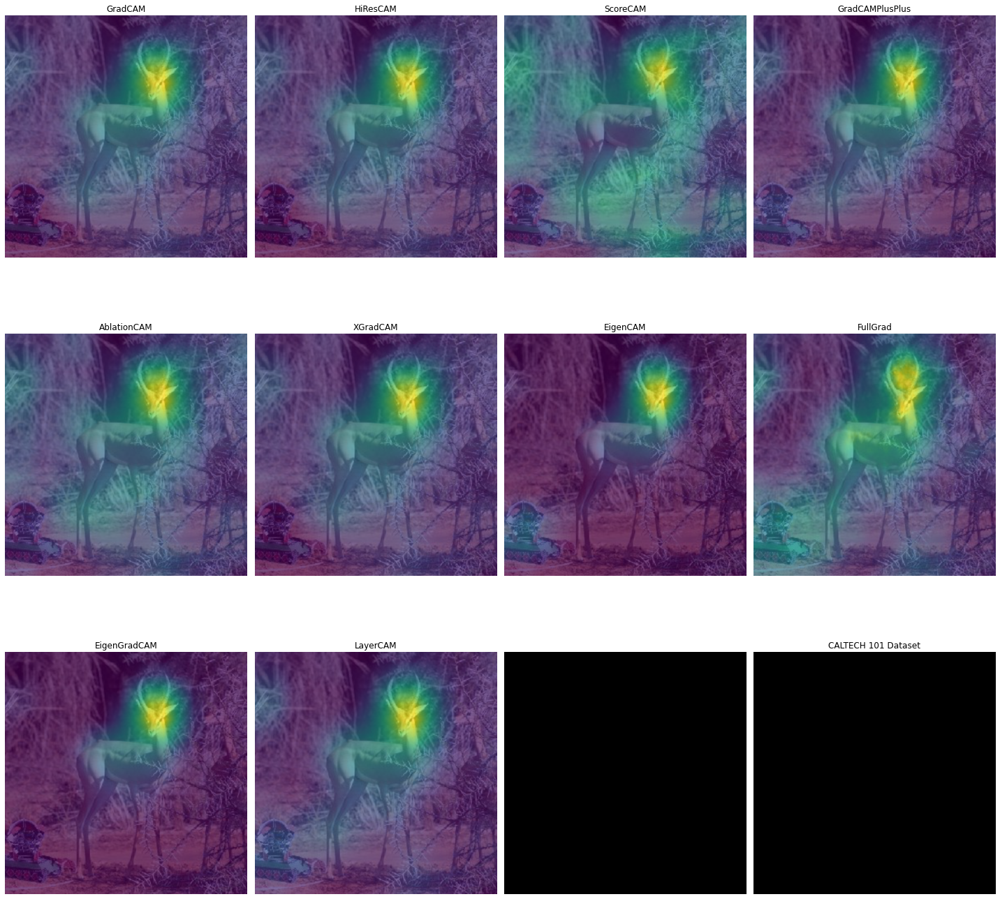

In [232]:
with open('CALTECH_101_fig_randombox_plt.pkl', 'rb') as file:
    fig_randombox_plt = pickle.load(file)
fig_randombox_plt.show()

# randombox Image download

In [260]:
list(path.ls())

[Path('/home/csy/.fastai/data/caltech_101/gerenuk'),
 Path('/home/csy/.fastai/data/caltech_101/ceiling_fan'),
 Path('/home/csy/.fastai/data/caltech_101/electric_guitar'),
 Path('/home/csy/.fastai/data/caltech_101/schooner'),
 Path('/home/csy/.fastai/data/caltech_101/sunflower'),
 Path('/home/csy/.fastai/data/caltech_101/brain'),
 Path('/home/csy/.fastai/data/caltech_101/dolphin'),
 Path('/home/csy/.fastai/data/caltech_101/nautilus'),
 Path('/home/csy/.fastai/data/caltech_101/panda'),
 Path('/home/csy/.fastai/data/caltech_101/chair'),
 Path('/home/csy/.fastai/data/caltech_101/trilobite'),
 Path('/home/csy/.fastai/data/caltech_101/stapler'),
 Path('/home/csy/.fastai/data/caltech_101/beaver'),
 Path('/home/csy/.fastai/data/caltech_101/snoopy'),
 Path('/home/csy/.fastai/data/caltech_101/windsor_chair'),
 Path('/home/csy/.fastai/data/caltech_101/ant'),
 Path('/home/csy/.fastai/data/caltech_101/cougar_face'),
 Path('/home/csy/.fastai/data/caltech_101/octopus'),
 Path('/home/csy/.fastai/data/

In [860]:
len(list(path.ls()))

5394

In [370]:
temp_img = PILImage.create(get_image_files(path)[20])

In [371]:
temp_img = temp_img.resize([512,512], resample=None, box=None, reducing_gap=None)

In [372]:
(temp_w, temp_h) = (temp_img.shape[0], temp_img.shape[1])

In [373]:
temp_a = random.uniform(0, temp_w*0.8)
temp_b = random.uniform(0, temp_h*0.3)

In [374]:
temp_shape = [(temp_a, temp_b), (temp_a+200, temp_b+60)]
temp_font = ImageFont.truetype("DejaVuSans.ttf", round(temp_h*0.04))
temp_name = (str(list(path.ls())[20])+'-'+str(20)).split('/')[-1] + '.jpg'
temp_fname = temp_name.split('.')[0].split('-')[0]

In [375]:
temp_name

'dollar_bill-20.jpg'

In [376]:
temp_fname

'dollar_bill'

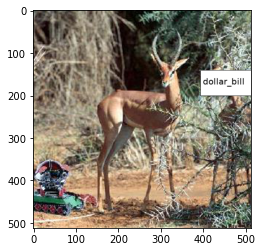

In [377]:
temp_img1 = ImageDraw.Draw(temp_img)  
temp_img1.rectangle(temp_shape, fill ="white", outline ="black")
ImageDraw.Draw(temp_img).text((temp_a+5, temp_b+15), temp_fname, (0,0,0), font=temp_font)
plt.imshow(temp_img)
temp_img.save("caltech_101_random/"+temp_name)

In [243]:
get_image_files(path)[9143]

Path('/home/csy/.fastai/data/caltech_101/hedgehog/image_0017.jpg')

In [237]:
len(path.ls())

102

In [416]:
# for i in range(len(str(list(path.ls())))-1) :
#     img = PILImage.create(get_image_files(path)[i])
#     img = img.resize([512,512], resample=None, box=None, reducing_gap=None)
#     (w, h) = (img.shape[0], img.shape[1])
#     a = random.uniform(0, w*0.8)
#     b = random.uniform(0, h*0.3)
#     shape = [(a, b), (a+200, b+60)]
#     font = ImageFont.truetype("DejaVuSans.ttf", round(h*0.04))
#     name = (os.path.dirname(get_image_files(path)[i]).split('/')[-1]+'-'+str(i)).split('/')[-1] + '.jpg'
#     fname = name.split('.')[0].split('-')[0]
#     img1 = ImageDraw.Draw(img)  
#     img1.rectangle(shape, fill ="white", outline ="black")
#     ImageDraw.Draw(img).text((a+5, b+15), fname, (0,0,0), font=font)
#     img.save("caltech_101_random/"+name)

# randombox

In [676]:
path_r=Path('caltech_101_random')   #랜덤박스넣은사진

In [677]:
path_r.ls()

(#5394) [Path('caltech_101_random/Motorbikes-2934.jpg'),Path('caltech_101_random/beaver-782.jpg'),Path('caltech_101_random/Motorbikes-2975.jpg'),Path('caltech_101_random/beaver-796.jpg'),Path('caltech_101_random/BACKGROUND_Google-3983.jpg'),Path('caltech_101_random/Motorbikes-2599.jpg'),Path('caltech_101_random/laptop-3308.jpg'),Path('caltech_101_random/airplanes-5324.jpg'),Path('caltech_101_random/airplanes-5329.jpg'),Path('caltech_101_random/flamingo_head-1941.jpg')...]

In [678]:
files_r=get_image_files(path_r)

In [679]:
def label_func(f):
    return f[0].split('-')[0]

In [680]:
dls_r=ImageDataLoaders.from_name_func(
    path_r,files,label_func,item_tfms=Resize(512)) 

#### (2) 학습 

In [681]:
lrnr_r=cnn_learner(dls_r,resnet34,metrics=error_rate)
lrnr_r.fine_tune(1)

epoch,train_loss,valid_loss,error_rate,time
0,2.194400,0.814425,0.234694,00:30


epoch,train_loss,valid_loss,error_rate,time
0,0.633236,0.386290,0.114100,00:36


In [682]:
net1_r=lrnr_r.model[0]
net2_r=lrnr_r.model[1] 

In [683]:
net2_r

Sequential(
  (0): AdaptiveConcatPool2d(
    (ap): AdaptiveAvgPool2d(output_size=1)
    (mp): AdaptiveMaxPool2d(output_size=1)
  )
  (1): fastai.layers.Flatten(full=False)
  (2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): Dropout(p=0.25, inplace=False)
  (4): Linear(in_features=1024, out_features=512, bias=False)
  (5): ReLU(inplace=True)
  (6): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): Dropout(p=0.5, inplace=False)
  (8): Linear(in_features=512, out_features=23, bias=False)
)

In [684]:
net2_r = torch.nn.Sequential(
    torch.nn.AdaptiveAvgPool2d(output_size=1), 
    torch.nn.Flatten(),
    torch.nn.Linear(512,out_features=23,bias=False))

In [685]:
net_r=torch.nn.Sequential(net1_r,net2_r)

In [686]:
lrnr2_r=Learner(dls_r,net_r,metrics=accuracy) 

In [687]:
lrnr2_r.fine_tune(5) 

epoch,train_loss,valid_loss,accuracy,time
0,0.990693,7.214967,0.175325,00:36


epoch,train_loss,valid_loss,accuracy,time
0,0.191813,0.626072,0.789425,00:36
1,0.138365,0.371003,0.892393,00:36
2,0.059181,0.026200,0.996289,00:36
3,0.019740,0.011075,0.997217,00:36
4,0.006568,0.010148,0.997217,00:36


---

# Step by step

<Axes: >

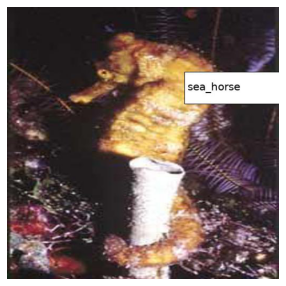

In [688]:
x_r, = first(dls.test_dl([PILImage.create(get_image_files(path_r)[532])]))
dls.train.decode((x_r,))[0].squeeze().show()

In [692]:
camimg_r = torch.einsum('ij,jkl -> ikl', net2_r[2].weight, net1_r(x_r).squeeze())

In [695]:
ebayesthresh = importr('EbayesThresh').ebayesthresh

power_threshed=np.array(ebayesthresh(FloatVector(torch.tensor(camimg_r[0].detach().reshape(-1))**2)))
ybar_threshed = np.where(power_threshed>20,torch.tensor(camimg_r[0].detach().reshape(-1)).cpu(),0)
ybar_threshed = torch.tensor(ybar_threshed.reshape(16,16))

power_threshed2=np.array(ebayesthresh(FloatVector(torch.tensor(camimg_r[1].detach().reshape(-1))**2)))
ybar_threshed2 = np.where(power_threshed2>20,torch.tensor(camimg_r[1].detach().reshape(-1)).cpu(),0)
ybar_threshed2 = torch.tensor(ybar_threshed2.reshape(16,16))

<ipython-input-695-1fb834e23ce9>:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  power_threshed=np.array(ebayesthresh(FloatVector(torch.tensor(camimg_r[0].detach().reshape(-1))**2)))
<ipython-input-695-1fb834e23ce9>:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  ybar_threshed = np.where(power_threshed>20,torch.tensor(camimg_r[0].detach().reshape(-1)).cpu(),0)
<ipython-input-695-1fb834e23ce9>:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  power_threshed2=np.array(ebayesthresh(FloatVector(torch.tensor(camimg_r[1].detach().reshape(-1))*

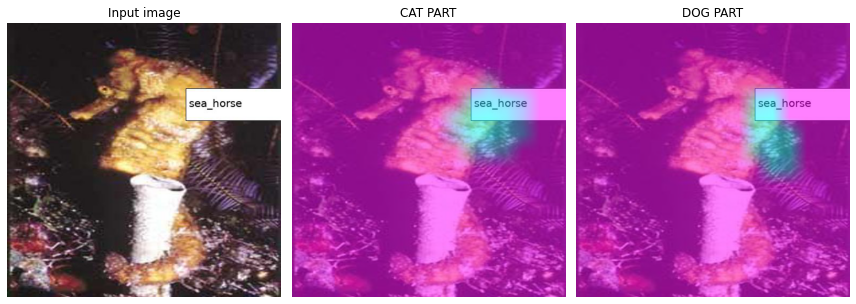

In [696]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3) 
# 
dls.train.decode((x_r,))[0].squeeze().show(ax=ax1)
ax1.set_title("Input image")
# 
dls.train.decode((x_r,))[0].squeeze().show(ax=ax2)
ax2.imshow((ybar_threshed).to("cpu").detach(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
# ax2.set_title("CAT PART")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax3)
ax3.imshow((ybar_threshed2).to("cpu").detach(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
# ax3.set_title("DOG PART")
#
fig.set_figwidth(12)            
fig.set_figheight(12)
fig.tight_layout()

- 판단 근거가 강할 수록 파란색 -> 보라색

## mode 1

In [697]:
# test=camimg_o[0]-torch.min(camimg_o[0])
A1=torch.exp(-0.05*(ybar_threshed))
A2 = 1 - A1

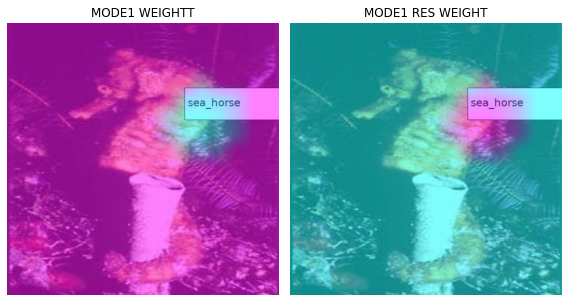

In [698]:
fig, (ax1,ax2) = plt.subplots(1,2) 
# 
dls.train.decode((x_r,))[0].squeeze().show(ax=ax1)
ax1.imshow(A2.data.to("cpu").detach(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("MODE1 WEIGHTT")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax2)
ax2.imshow(A1.data.to("cpu").detach(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("MODE1 RES WEIGHT")
#
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

In [706]:
# mode 1 res
X1=np.array(A1.to("cpu").detach(),dtype=np.float32)
Y1=torch.Tensor(cv2.resize(X1,(512,512),interpolation=cv2.INTER_LINEAR))
x1=x_r.squeeze().to('cpu')*Y1-torch.min(x_r.squeeze().to('cpu'))*Y1

# mode 1
X12=np.array(A2.to("cpu").detach(),dtype=np.float32)
Y12=torch.Tensor(cv2.resize(X12,(512,512),interpolation=cv2.INTER_LINEAR))
x12=x_r.squeeze().to('cpu')*Y12-torch.min(x_r.squeeze().to('cpu'))*Y12

`-` 1st CAM 분리

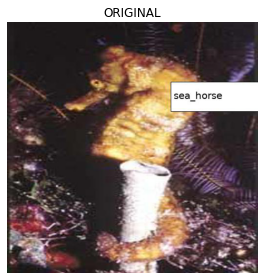

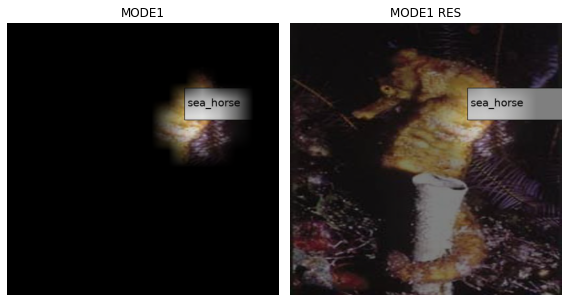

In [857]:
fig, (ax1) = plt.subplots(1,1) 
dls.train.decode((x_r,))[0].squeeze().show(ax=ax1)
ax1.set_title("ORIGINAL")
fig.set_figwidth(4)            
fig.set_figheight(4)
fig.tight_layout()
#
fig, (ax1, ax2) = plt.subplots(1,2) 
(x12*-1.5).squeeze().show(ax=ax1)  #MODE1
(x1*0.5).squeeze().show(ax=ax2)  #MODE1_res
ax1.set_title("MODE1")
ax2.set_title("MODE1 RES")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

In [720]:
x1 = x1.reshape(1,3,512,512)

In [722]:
net1_r.to('cpu')
net2_r.to('cpu')

Sequential(
  (0): AdaptiveAvgPool2d(output_size=1)
  (1): Flatten(start_dim=1, end_dim=-1)
  (2): Linear(in_features=512, out_features=23, bias=False)
)

In [723]:
camimg1_r = torch.einsum('ij,jkl -> ikl', net2_r[2].weight, net1_r(x1).squeeze())

In [724]:
power_threshed3=np.array(ebayesthresh(FloatVector(torch.tensor(camimg1_r[0].detach().reshape(-1))**2)))
ybar_threshed3 = np.where(power_threshed3>20,torch.tensor(camimg1_r[0].detach().reshape(-1)),0)
ybar_threshed3 = torch.tensor(ybar_threshed3.reshape(16,16))

power_threshed4=np.array(ebayesthresh(FloatVector(torch.tensor(camimg1_r[1].detach().reshape(-1))**2)))
ybar_threshed4 = np.where(power_threshed4>20,torch.tensor(camimg1_r[1].detach().reshape(-1)),0)
ybar_threshed4 = torch.tensor(ybar_threshed4.reshape(16,16))

<ipython-input-724-c83bfb4d70dd>:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  power_threshed3=np.array(ebayesthresh(FloatVector(torch.tensor(camimg1_r[0].detach().reshape(-1))**2)))
<ipython-input-724-c83bfb4d70dd>:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  ybar_threshed3 = np.where(power_threshed3>20,torch.tensor(camimg1_r[0].detach().reshape(-1)),0)
<ipython-input-724-c83bfb4d70dd>:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  power_threshed4=np.array(ebayesthresh(FloatVector(torch.tensor(camimg1_r[1].detach().reshape(-1))*

`-` mode1 res 

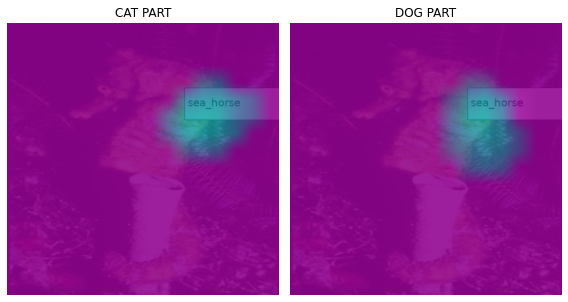

In [726]:
fig, (ax1,ax2) = plt.subplots(1,2) 
# 
(x1*0.25).squeeze().show(ax=ax1)
ax1.imshow(ybar_threshed3,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("CAT PART")
#
(x1*0.25).squeeze().show(ax=ax2)
ax2.imshow(ybar_threshed4,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DOG PART")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

`-` 첫번째 CAM 결과와 비교

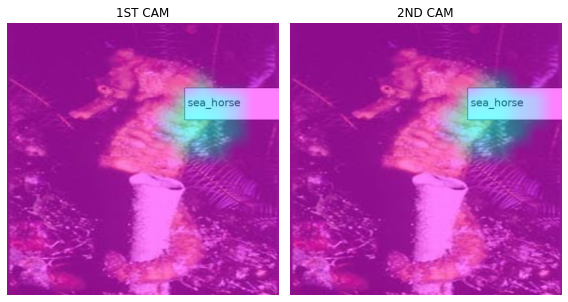

In [727]:
fig, (ax1,ax2) = plt.subplots(1,2) 
# 
dls.train.decode((x_r,))[0].squeeze().show(ax=ax1)
ax1.imshow(ybar_threshed,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("1ST CAM")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax2)
ax2.imshow(ybar_threshed3,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("2ND CAM")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

`-` 2nd CAM 분리

In [728]:
# test1=camimg1[0]-torch.min(camimg1[0])
A3 = torch.exp(-0.05*(ybar_threshed3))
A4 = 1 - A3

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


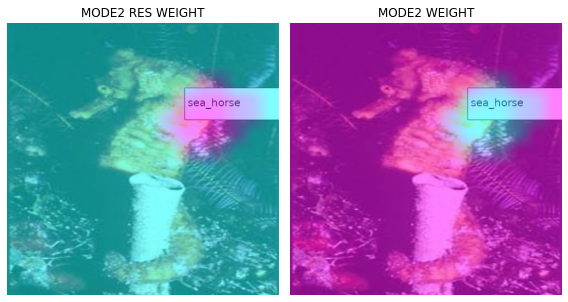

In [729]:
fig, (ax1,ax2) = plt.subplots(1,2) 
# 
x1.squeeze().show(ax=ax2)
dls.train.decode((x1,))[0].squeeze().show(ax=ax1)
ax1.imshow(A3.data.to("cpu").detach(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("MODE2 RES WEIGHT")
#
x1.squeeze().show(ax=ax2)
dls.train.decode((x1,))[0].squeeze().show(ax=ax2)
ax2.imshow(A4.data.to("cpu").detach(),alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("MODE2 WEIGHT")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

In [730]:
X2=np.array(A3.to("cpu").detach(),dtype=np.float32)
Y2=torch.Tensor(cv2.resize(X2,(512,512),interpolation=cv2.INTER_LINEAR))
x2=(x1)*Y2-torch.min((x1)*Y2)

X22=np.array(A4.to("cpu").detach(),dtype=np.float32)
Y22=torch.Tensor(cv2.resize(X22,(512,512),interpolation=cv2.INTER_LINEAR))
x22=(x1)*Y22-torch.min((x1)*Y22)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


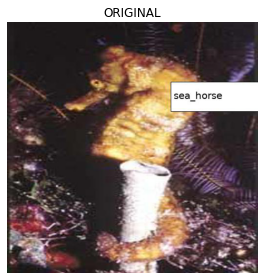

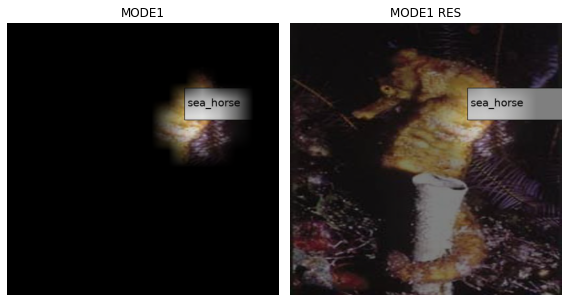

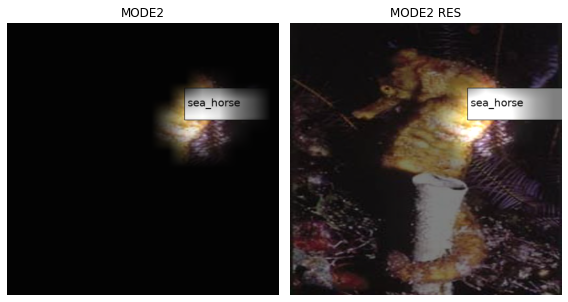

In [858]:
fig, (ax1) = plt.subplots(1,1) 
dls.train.decode((x_r,))[0].squeeze().show(ax=ax1)
ax1.set_title("ORIGINAL")
fig.set_figwidth(4)            
fig.set_figheight(4)
fig.tight_layout()
#
fig, (ax1, ax2) = plt.subplots(1,2) 
(x12*-1.5).squeeze().show(ax=ax1)  #MODE1
(x1*0.5).squeeze().show(ax=ax2)  #MODE1_res
ax1.set_title("MODE1")
ax2.set_title("MODE1 RES")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()
#
fig, (ax1, ax2) = plt.subplots(1,2) 
(-x22+1).squeeze().show(ax=ax1)  #MODE2
(x2*0.5).squeeze().show(ax=ax2)  #MODE2_res
ax1.set_title("MODE2")
ax2.set_title("MODE2 RES")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

In [742]:
x2 = x2.reshape(1,3,512,512)

In [743]:
net1_r.to('cpu')
net2_r.to('cpu')

Sequential(
  (0): AdaptiveAvgPool2d(output_size=1)
  (1): Flatten(start_dim=1, end_dim=-1)
  (2): Linear(in_features=512, out_features=23, bias=False)
)

In [745]:
camimg2_r = torch.einsum('ij,jkl -> ikl', net2_r[2].weight, net1_r(x2).squeeze())

In [746]:
power_threshed5=np.array(ebayesthresh(FloatVector(torch.tensor(camimg2_r[0].detach().reshape(-1))**2)))
ybar_threshed5 = np.where(power_threshed5>10,torch.tensor(camimg2_r[0].detach().reshape(-1)),0)
ybar_threshed5 = torch.tensor(ybar_threshed5.reshape(16,16))

power_threshed6=np.array(ebayesthresh(FloatVector(torch.tensor(camimg2_r[1].detach().reshape(-1))**2)))
ybar_threshed6 = np.where(power_threshed6>10,torch.tensor(camimg2_r[1].detach().reshape(-1)),0)
ybar_threshed6 = torch.tensor(ybar_threshed6.reshape(16,16))

<ipython-input-746-f3a70d6c47ba>:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  power_threshed5=np.array(ebayesthresh(FloatVector(torch.tensor(camimg2_r[0].detach().reshape(-1))**2)))
<ipython-input-746-f3a70d6c47ba>:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  ybar_threshed5 = np.where(power_threshed5>10,torch.tensor(camimg2_r[0].detach().reshape(-1)),0)
<ipython-input-746-f3a70d6c47ba>:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  power_threshed6=np.array(ebayesthresh(FloatVector(torch.tensor(camimg2_r[1].detach().reshape(-1))*

`-` mode2 res 에 CAM 결과 올리기

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


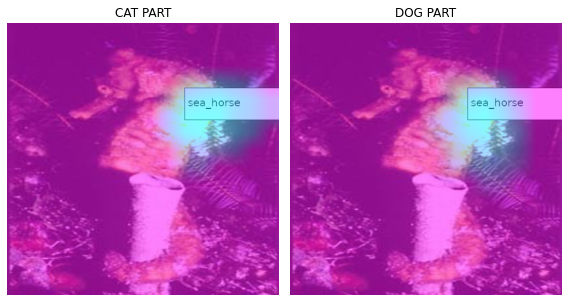

In [747]:
fig, (ax1, ax2) = plt.subplots(1,2) 
#
x2.squeeze().show(ax=ax1)
ax1.imshow(ybar_threshed5,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("CAT PART")
#
x2.squeeze().show(ax=ax2)
ax2.imshow(ybar_threshed6,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DOG PART")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

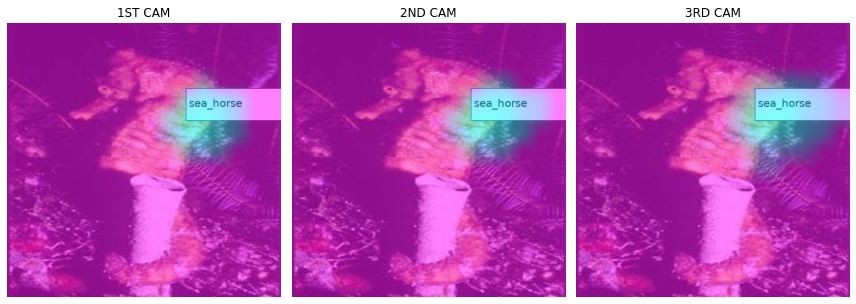

In [748]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3) 
# 
dls.train.decode((x_r,))[0].squeeze().show(ax=ax1)
ax1.imshow(ybar_threshed,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("1ST CAM")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax2)
ax2.imshow(ybar_threshed3,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("2ND CAM")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax3)
ax3.imshow(ybar_threshed5,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax3.set_title("3RD CAM")
fig.set_figwidth(12)            
fig.set_figheight(12)
fig.tight_layout()

## mode 3 만들기

In [657]:
# test2=camimg2[0]-torch.min(camimg2[0])

In [749]:
A5 = torch.exp(-0.05*(ybar_threshed5))

In [750]:
A6 = 1 - A5

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


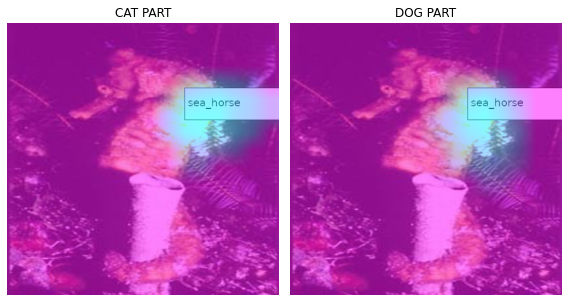

In [751]:
fig, (ax1, ax2) = plt.subplots(1,2) 
#
x2.squeeze().show(ax=ax1)
ax1.imshow(ybar_threshed5,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax1.set_title("CAT PART")
#
x2.squeeze().show(ax=ax2)
ax2.imshow(ybar_threshed6,alpha=0.5,extent=(0,511,511,0),interpolation='bilinear',cmap='cool')
ax2.set_title("DOG PART")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

In [752]:
#mode 3 res
X3=np.array(A5.to("cpu").detach(),dtype=np.float32)
Y3=torch.Tensor(cv2.resize(X3,(512,512),interpolation=cv2.INTER_LINEAR))
x3=x2*Y3-torch.min(x2*Y3)
# mode 3
X32=np.array(A6.to("cpu").detach(),dtype=np.float32)
Y32=torch.Tensor(cv2.resize(X32,(512,512),interpolation=cv2.INTER_LINEAR))
x32=x2*Y32-torch.min(x2*Y32)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


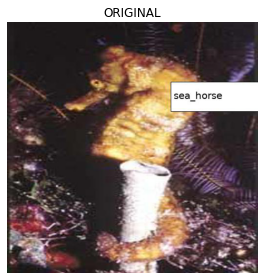

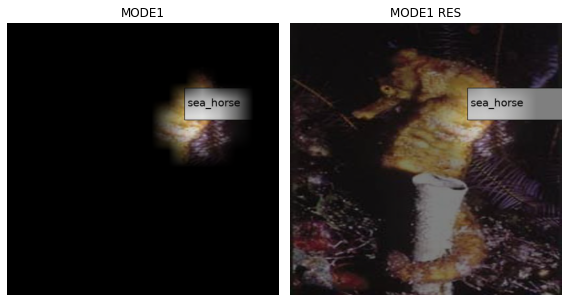

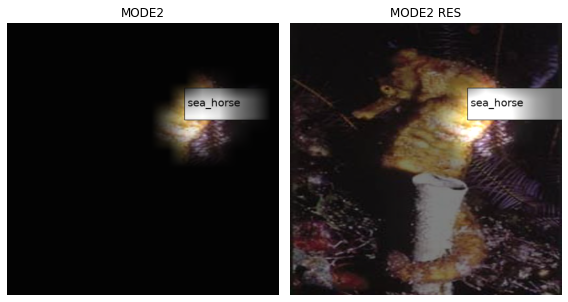

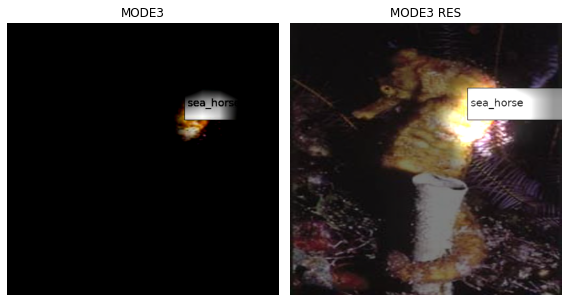

In [846]:
fig, (ax1) = plt.subplots(1,1) 
dls.train.decode((x_r,))[0].squeeze().show(ax=ax1)
ax1.set_title("ORIGINAL")
fig.set_figwidth(4)            
fig.set_figheight(4)
fig.tight_layout()

with open('CALTECH_101_random_hcam_cat_plt1.pkl', 'wb') as file:
    pickle.dump(fig, file)
#
fig, (ax1, ax2) = plt.subplots(1,2) 
(x12*-1.5).squeeze().show(ax=ax1)  #MODE1
(x1*0.5).squeeze().show(ax=ax2)  #MODE1_res
ax1.set_title("MODE1")
ax2.set_title("MODE1 RES")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()
with open('CALTECH_101_random_hcam_cat_plt2.pkl', 'wb') as file:
    pickle.dump(fig, file)
    
#
fig, (ax1, ax2) = plt.subplots(1,2) 
(-x22+1).squeeze().show(ax=ax1)  #MODE2
(x2*0.5).squeeze().show(ax=ax2)  #MODE2_res
ax1.set_title("MODE2")
ax2.set_title("MODE2 RES")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()
with open('CALTECH_101_random_hcam_cat_plt3.pkl', 'wb') as file:
    pickle.dump(fig, file)
    
#
fig, (ax1, ax2) = plt.subplots(1,2) 
(-x32+1).squeeze().show(ax=ax1)  #MODE3
(x3*0.5).squeeze().show(ax=ax2)  #MODE3_res
ax1.set_title("MODE3")
ax2.set_title("MODE3 RES")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

with open('CALTECH_101_random_hcam_cat_plt4.pkl', 'wb') as file:
    pickle.dump(fig, file)

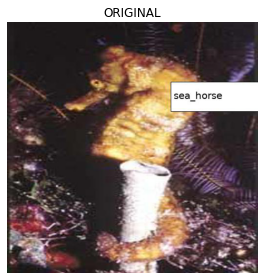

In [847]:
with open('CALTECH_101_random_hcam_cat_plt1.pkl', 'rb') as file:
    hcam_cat_plt = pickle.load(file)
plt.show(hcam_cat_plt)

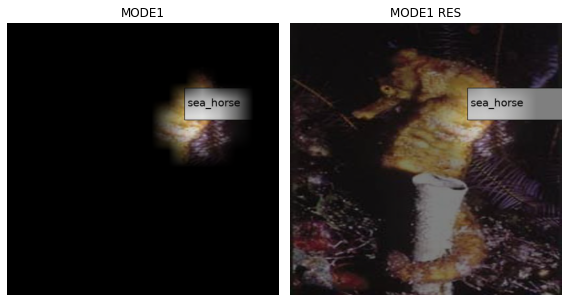

In [848]:
with open('CALTECH_101_random_hcam_cat_plt2.pkl', 'rb') as file:
    hcam_cat_plt = pickle.load(file)
plt.show(hcam_cat_plt)

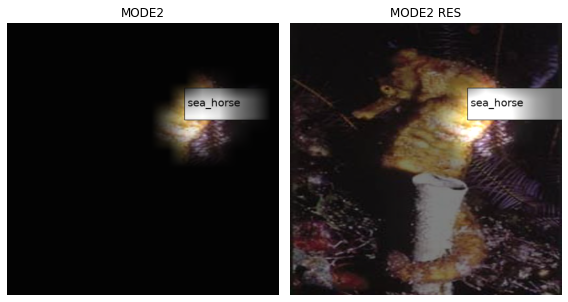

In [849]:
with open('CALTECH_101_random_hcam_cat_plt3.pkl', 'rb') as file:
    hcam_cat_plt = pickle.load(file)
plt.show(hcam_cat_plt)

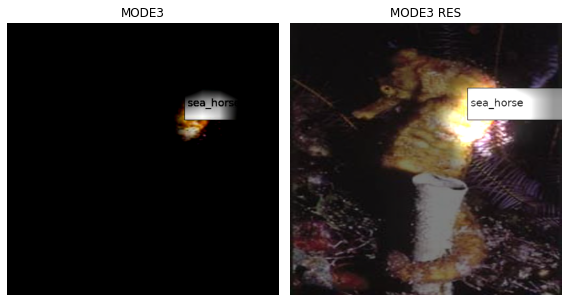

In [850]:
with open('CALTECH_101_random_hcam_cat_plt4.pkl', 'rb') as file:
    hcam_cat_plt = pickle.load(file)
plt.show(hcam_cat_plt)

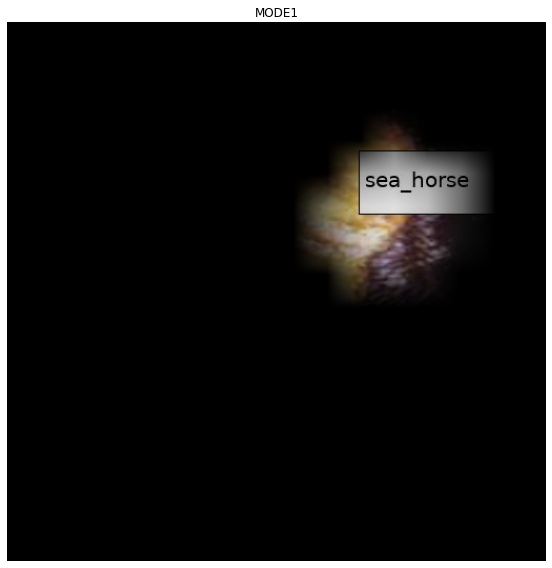

In [851]:
fig, (ax1) = plt.subplots(1,1) 
(x12*-1.5).squeeze().show(ax=ax1)  #MODE1
ax1.set_title("MODE1")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

with open('CALTECH_101_random_hcam_cat_plt_mode1.pkl', 'wb') as file:
    pickle.dump(fig, file)

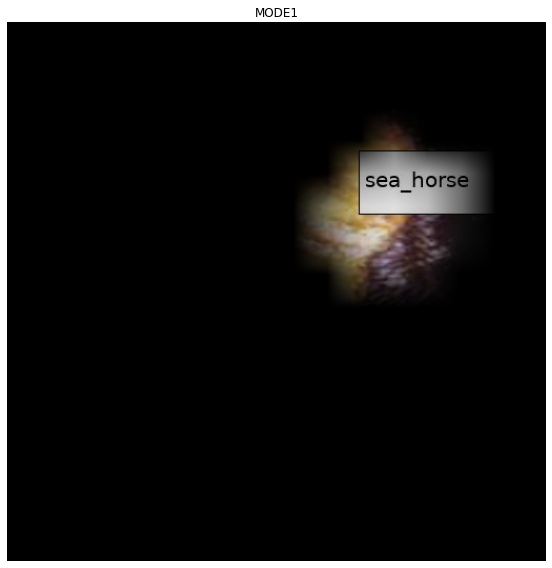

In [852]:
with open('CALTECH_101_random_hcam_cat_plt_mode1.pkl', 'rb') as file:
    hcam_cat_plt_mode1 = pickle.load(file)
plt.show(hcam_cat_plt_mode1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


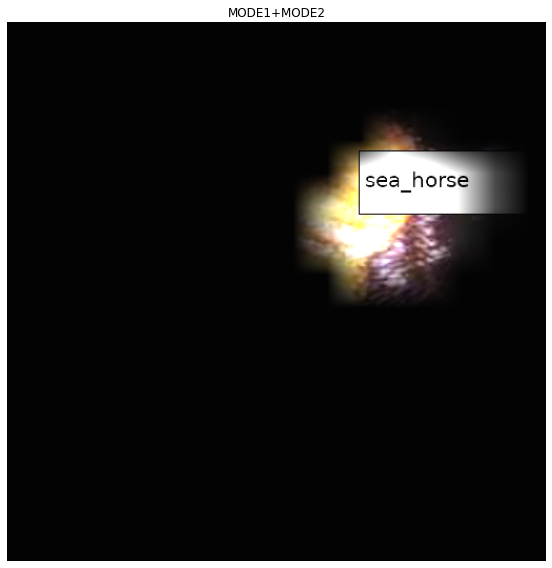

In [853]:
fig, (ax1) = plt.subplots(1,1) 
(x12*-1.5 + -x22+1).squeeze().show(ax=ax1)  #MODE1+MODE2
ax1.set_title("MODE1+MODE2")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

with open('CALTECH_101_random_hcam_cat_plt_mode2.pkl', 'wb') as file:
    pickle.dump(fig, file)

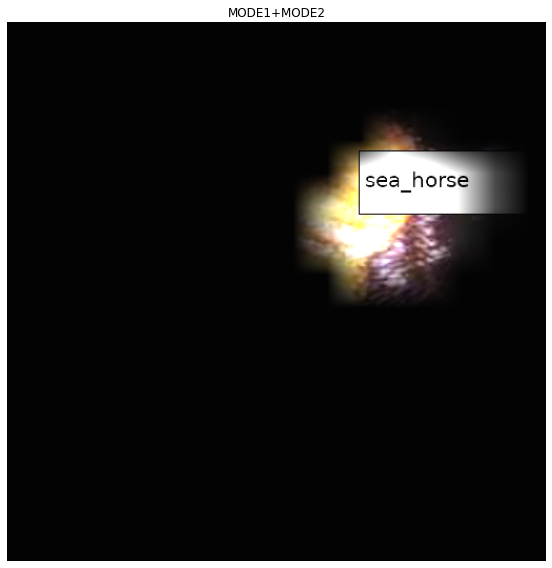

In [854]:
with open('CALTECH_101_random_hcam_cat_plt_mode2.pkl', 'rb') as file:
    hcam_cat_plt_mode2 = pickle.load(file)
plt.show(hcam_cat_plt_mode2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


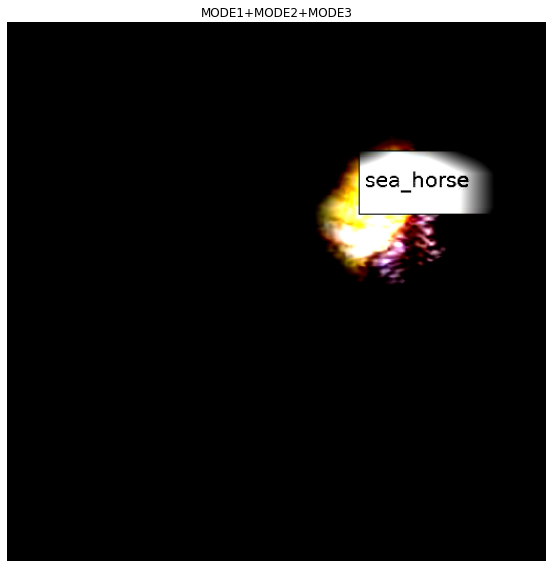

In [855]:
fig, (ax1) = plt.subplots(1,1) 
(x12*-1.5 + -x22+1 + -x32+1).squeeze().show(ax=ax1)  #MODE1+MODE2+MODE3
ax1.set_title("MODE1+MODE2+MODE3")
fig.set_figwidth(8)            
fig.set_figheight(8)
fig.tight_layout()

with open('CALTECH_101_random_hcam_cat_plt_mode3.pkl', 'wb') as file:
    pickle.dump(fig, file)

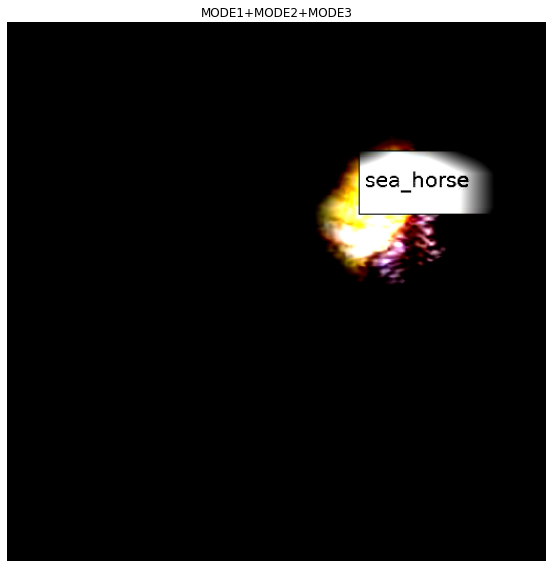

In [856]:
with open('CALTECH_101_random_hcam_cat_plt_mode3.pkl', 'rb') as file:
    hcam_cat_plt_mode3 = pickle.load(file)
plt.show(hcam_cat_plt_mode3)

# Randombox Other Methods

In [775]:
x_r = x_r.to('cpu')

# GradCAM

In [777]:
gradcam_randombox = GradCAM(model=lrnr_r.model.to('cpu'), target_layers=lrnr_r.model[0][-1])

In [778]:
cam_gradcam_randombox = gradcam_randombox(input_tensor=x_r,targets=None)

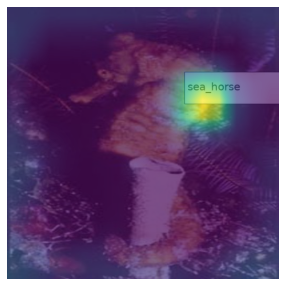

In [779]:
dls.train.decode((x_r,))[0].squeeze().show()
plt.imshow(cam_gradcam_randombox.squeeze(), alpha=0.7)

# HiResCAM

In [780]:
hirescam_randombox = HiResCAM(model=lrnr_r.model.to('cpu'), target_layers=lrnr_r.model[0][-1])

In [781]:
cam_hirescam_randombox = hirescam_randombox(input_tensor=x_r,targets=None)

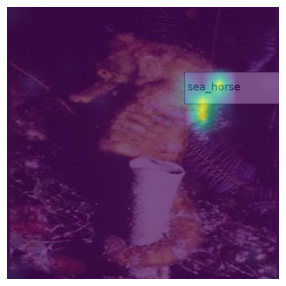

In [782]:
dls.train.decode((x_r,))[0].squeeze().show()
plt.imshow(cam_hirescam_randombox.squeeze(), alpha=0.7)

# ScoreCAM

In [783]:
scorecam_randombox = ScoreCAM(model=lrnr_r.model.to('cpu'), target_layers=lrnr_r.model[0][-1])

In [784]:
cam_scorecam_randombox = scorecam_randombox(input_tensor=x_r,targets=None)

100%|██████████| 32/32 [00:24<00:00,  1.31it/s]


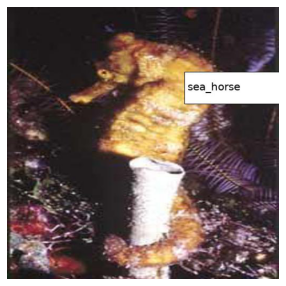

In [785]:
dls.train.decode((x_r,))[0].squeeze().show()
plt.imshow(cam_scorecam_randombox.squeeze(), alpha=0.7)

# GradCAMPlusPlus

In [786]:
gradcamplusplus_randombox = GradCAMPlusPlus(model=lrnr_r.model.to('cpu'), target_layers=lrnr_r.model[0][-1])

In [787]:
cam_gradcamplusplus_randombox = gradcamplusplus_randombox(input_tensor=x_r,targets=None)

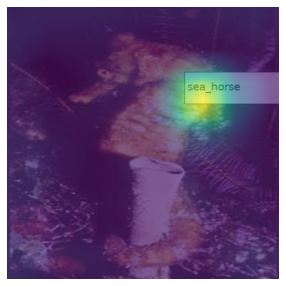

In [788]:
dls.train.decode((x_r,))[0].squeeze().show()
plt.imshow(cam_gradcamplusplus_randombox.squeeze(), alpha=0.7)

# AblationCAM

In [789]:
ablationcam_randombox = AblationCAM(model=lrnr_r.model.to('cpu'), target_layers=lrnr_r.model[0][-1])

In [790]:
cam_ablationcam_randombox = ablationcam_randombox(input_tensor=x_r,targets=None)

100%|██████████| 16/16 [00:25<00:00,  1.57s/it]


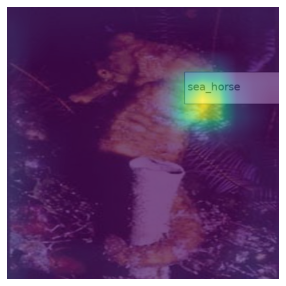

In [791]:
dls.train.decode((x_r,))[0].squeeze().show()
plt.imshow(cam_ablationcam_randombox.squeeze(), alpha=0.7)

# XGradCAM

In [792]:
xgradcam_randombox = XGradCAM(model=lrnr_r.model.to('cpu'), target_layers=lrnr_r.model[0][-1])

In [793]:
cam_xgradcam_randombox = xgradcam_randombox(input_tensor=x_r,targets=None)

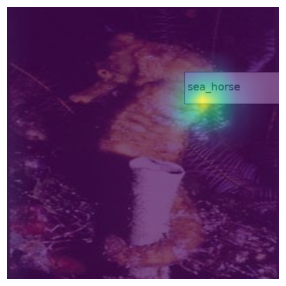

In [794]:
dls.train.decode((x_r,))[0].squeeze().show()
plt.imshow(cam_xgradcam_randombox.squeeze(), alpha=0.7)

# EigenCAM

In [795]:
eigencam_randombox = EigenCAM(model=lrnr_r.model.to('cpu'), target_layers=lrnr_r.model[0][-1])

In [796]:
cam_eigencam_randombox = eigencam_randombox(input_tensor=x_r,targets=None)

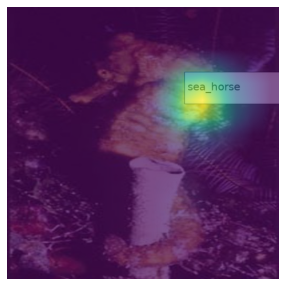

In [797]:
dls.train.decode((x_r,))[0].squeeze().show()
plt.imshow(cam_eigencam_randombox.squeeze(), alpha=0.7)

# FullGrad

In [798]:
fullgrad_randombox = FullGrad(model=lrnr_r.model.to('cpu'), target_layers=lrnr_r.model[0][-1])

In [799]:
cam_fullgrad_randombox = fullgrad_randombox(input_tensor=x_r,targets=None)

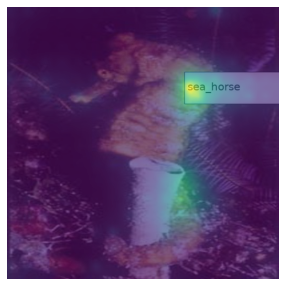

In [800]:
dls.train.decode((x_r,))[0].squeeze().show()
plt.imshow(cam_fullgrad_randombox.squeeze(), alpha=0.7)

# EigenGradCAM

In [801]:
eigengradcam_randombox = EigenGradCAM(model=lrnr_r.model.to('cpu'), target_layers=lrnr_r.model[0][-1])

In [802]:
cam_eigengradcam_randombox = eigengradcam_randombox(input_tensor=x_r,targets=None)

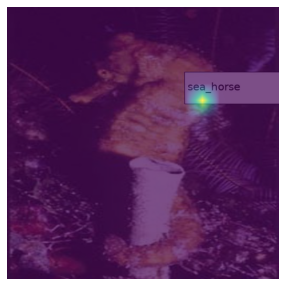

In [803]:
dls.train.decode((x_r,))[0].squeeze().show()
plt.imshow(cam_eigengradcam_randombox.squeeze(), alpha=0.7)

# LayerCAM

In [804]:
layercam_randombox = LayerCAM(model=lrnr_r.model.to('cpu'), target_layers=lrnr_r.model[0][-1])

In [805]:
cam_layercam_randombox = layercam_randombox(input_tensor=x_r,targets=None)

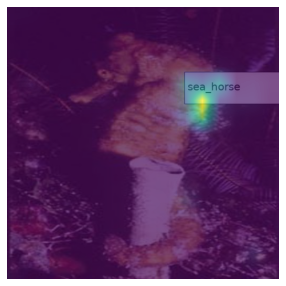

In [806]:
dls.train.decode((x_r,))[0].squeeze().show()
plt.imshow(cam_layercam_randombox.squeeze(), alpha=0.7)

## Figure_Randombox

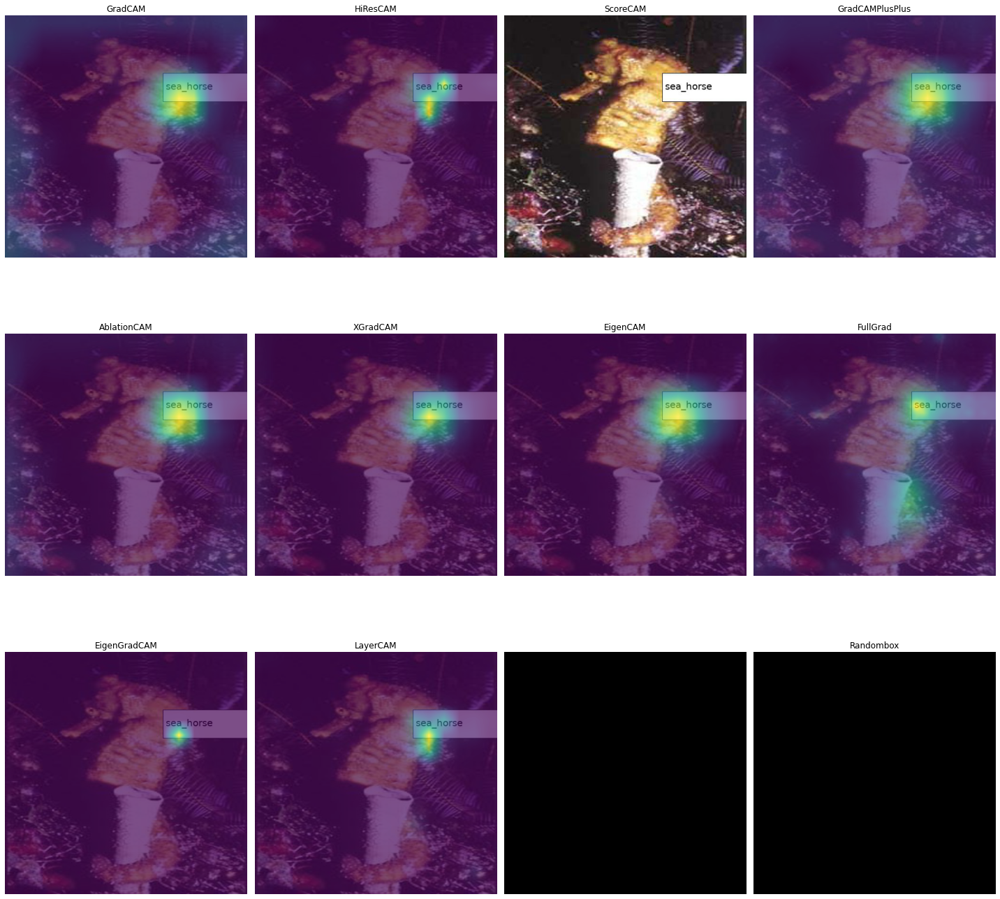

In [812]:
fig, ((ax1,ax2,ax3,ax4),
      (ax5,ax6,ax7,ax8),
      (ax9,ax10,ax11,ax12)) = plt.subplots(3,4) 
plt.title('Randombox')
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax1)
ax1.imshow(cam_gradcam_randombox.squeeze(), alpha=0.7)
ax1.set_title("GradCAM")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax2)
ax2.imshow(cam_hirescam_randombox.squeeze(), alpha=0.7)
ax2.set_title("HiResCAM")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax3)
ax3.imshow(cam_scorecam_randombox.squeeze(), alpha=0.7)
ax3.set_title("ScoreCAM")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax4)
ax4.imshow(cam_gradcamplusplus_randombox.squeeze(), alpha=0.7)
ax4.set_title("GradCAMPlusPlus")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax5)
ax5.imshow(cam_ablationcam_randombox.squeeze(), alpha=0.7)
ax5.set_title("AblationCAM")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax6)
ax6.imshow(cam_xgradcam_randombox.squeeze(), alpha=0.7)
ax6.set_title("XGradCAM")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax7)
ax7.imshow(cam_eigencam_randombox.squeeze(), alpha=0.7)
ax7.set_title("EigenCAM")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax8)
ax8.imshow(cam_fullgrad_randombox.squeeze(), alpha=0.7)
ax8.set_title("FullGrad")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax9)
ax9.imshow(cam_eigengradcam_randombox.squeeze(), alpha=0.7)
ax9.set_title("EigenGradCAM")
#
dls.train.decode((x_r,))[0].squeeze().show(ax=ax10)
ax10.imshow(cam_layercam_randombox.squeeze(), alpha=0.7)
ax10.set_title("LayerCAM")
#
(dls.train.decode((x_r,))[0].squeeze()*0).show(ax=ax11)
(dls.train.decode((x_r,))[0].squeeze()*0).show(ax=ax12)
#
fig.set_figwidth(20)            
fig.set_figheight(20)
fig.tight_layout()

with open('CALTECH_101_random_fig_randombox_plt.pkl', 'wb') as file:
    pickle.dump(fig, file)

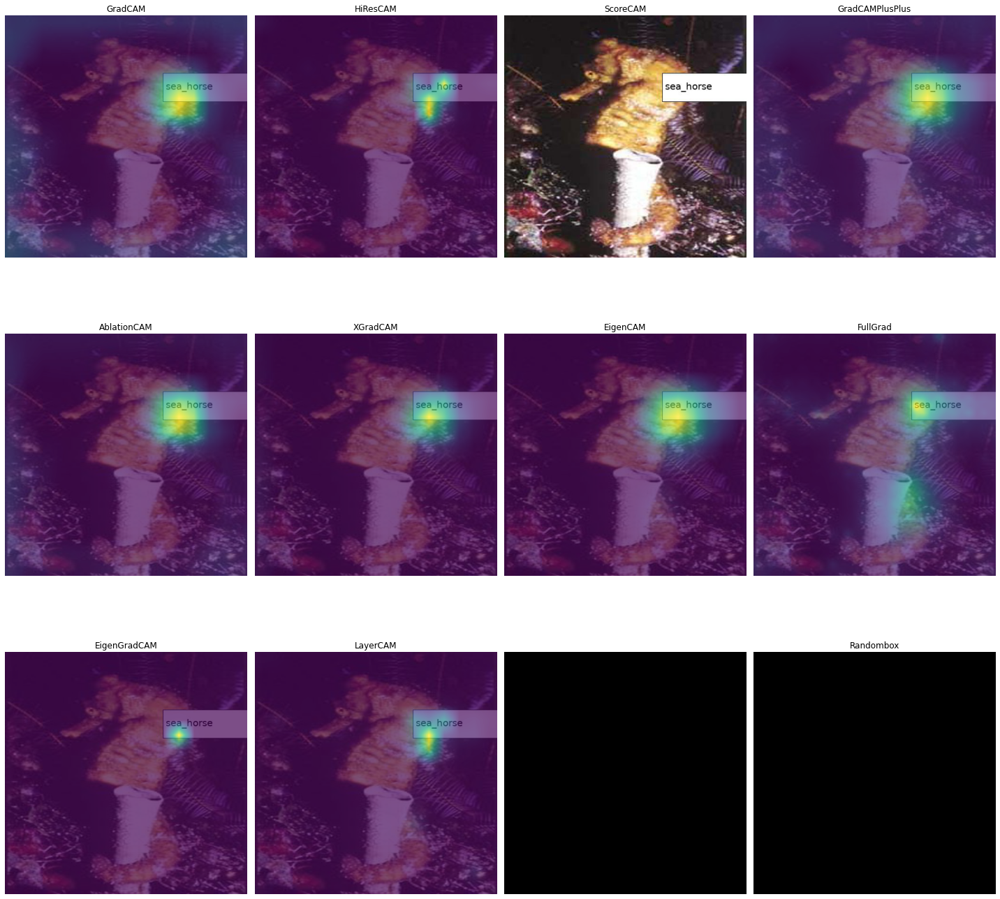

In [813]:
with open('CALTECH_101_random_fig_randombox_plt.pkl', 'rb') as file:
    fig_randombox_plt = pickle.load(file)
fig_randombox_plt.show()